# Learning a Mackey-Glass chaotic dynamical system

The goal of this notebook is to learn a Mackey-Glass chaotic dynamical system. We will begin, in [Section 1](#MackeyGlass_System), with some preliminaries on the Mackey-Glass system. Afterwards, in [Section 2](#Setting), we will set the task in detail. In addition, we will also explaining there how the rest of the notebook is structured. Such introduction is left until [Section 2](#Setting) since the preliminaries are quite necessary to understand it. 

The notebook is structured as follows.

+ [$\text{1. Intuition on the Mackey-Glass system}$](#MackeyGlass_System)
+ [$\text{2. Setting the task and definition of the main class}$](#Setting)
+ [$\text{3. Training the network taking a delay of }$$\sigma=17$](#Delay17)
    + [$\text{3.1 Training with a sequence of length T=3000}$](#Delay17_3000)
    + [$\text{3.2 Training with a sequence of length T=21000}$](#Delay17_21000)
    + [$\text{3.3 Comparison: T=3000 vs T=21000}$](#Delay17_Comparison)   
    + [$\text{3.4 Increasing network's capacity}$](#Delay17_Capacity)
+ [$\text{4. Training the network taking a delay of $\sigma=30$}$](#Delay30)
    + [$\text{4.1 Training with a sequence of length T=3000}$](#Delay30_3000)
    + [$\text{4.2 Training with a sequence of length T=21000}$](#Delay30_21000)
    + [$\text{4.3 Comparison: T=3000 vs T=21000}$](#Delay30_Comparison)
    + [$\text{4.4 Increasing network's capacity}$](#Delay30_Capacity)
+ [$\text{5. Training the network with different delays}$](#MackeyGlass_VaryDelay)
    + [$\text{5.1 $\sigma=20$}$](#VaryDelay_20)
    + [$\text{5.2 $\sigma=25$}$](#VaryDelay_25)
    + [$\text{5.3 $\sigma=27$}$](#VaryDelay_27)

# 1. Intuition on the Mackey-Glass system <a name="MackeyGlass_System" ></a>

The Mackey-Glass system is determined by the following *delay differential equation*

$$
\dot{y}(t)=\frac{\alpha y(t-\sigma)}{1+y(t-\sigma)^\beta}-\gamma y(t),
$$

where $\alpha,\beta,\gamma >0$. This system has different behaviors depending on the parameters. For instance, it may have a fixed point, it may oscillate or it may display a chaotic dynamics.

The parameters we are going to use are the standard ones. That is, $\alpha=0.2,\beta=10$ and $\gamma=1$. Therefore, the equation becomes

$$
\dot{y}(t)=\frac{0.2\, y(t-\sigma)}{1+y(t-\sigma)^{10}}-0.1\, y(t),
$$

where $\sigma>0$ stands for the time delay. Under such conditions, the system becomes chaotic for $\sigma>16.8$.

It can be seen that the discrete approximation to the continuous solution of the system is

$$
y(n+1)=y(n)+\delta\left[\frac{0.2\, y(n-\frac{\sigma}{\delta})}{1+y(n-\frac{\sigma}{\delta})^{10}}-0.1\, y(n)\right],
$$

where $\delta=1/10$. Finally, in order to achieve that a unit in the discrte approach is the same as a unit in the continuous approach, a subsampling by 10 should be performed. In other words, after the subsampling, one can guarantee that one time step from *y(n)* to *y(n+1)* by means of the above formula corresponds to a unit time step from *y(t)* to *y(t+1)* of the original continuous system.

There are two common ways of visualizing such systems. The first one would be the time series itself, which means $y$ as a function of $n$. The second one consists in plotting the trajectory followed by any point $(y(n),y(n-\sigma))$.

Let us now see the behavior of the Mackey-Glass system (taking $\alpha=0.2, \beta=10, \gamma=0.1$ and $\delta=1/10$) for different values of $\sigma$. We will use both ways of visualization. 

We are going to consider different initial conditions y(0). In addition, we will always regard y(n)=0 for n<0.

In [1]:
import matplotlib.pyplot as plt
import numpy as np

In [2]:
def visualize_MG(sigmas, num_time_steps=1200, cond_in=1.2):
    """
    Input:
    -sigmas is a list of values of sigma
    -num_time_steps is the number of time steps we want to plot
    -cond_in is the initial condition y(0)
    """
    alpha = 0.2
    beta = 10
    gamma = 0.1
    delta = 0.1
    sigmas = sigmas
    
    count = 0
    for sigma in sigmas:
        #compute y
        N = 10*num_time_steps+int(sigma/delta)
        y = np.zeros(N)
        y[int(sigma/delta)] = cond_in
        for n in np.arange(int(sigma/delta), N-1):
            y[n+1] = y[n]+delta*((alpha*y[n-int(sigma/delta)])/(1+y[n-int(sigma/delta)]**beta)-gamma*y[n])
        
        #subsample
        y_subsample = y[int(sigma/delta):]
        y_subsample = y_subsample[0:len(y_subsample):10]
    
        #plots
        fig, axs = plt.subplots(1, 2, figsize=(13.5, 4))
        if count == 0:
            fig.suptitle('Initial condition of y(0)={}'.format(cond_in), fontsize = 18, y=1.1)
        axs[0].plot(np.arange(len(y_subsample)), y_subsample)  
        axs[0].set_title("Mackey-Glass time series with sigma = {}".format(sigma))
        axs[0].set(xlabel="time", ylabel="y")
        axs[1].plot(y_subsample[sigma:], y_subsample[:len(y_subsample)-sigma]) 
        axs[1].set_title("Trajectory along {} time steps taking sigma={}".format(len(y_subsample[sigma:]),sigma))
        axs[1].set(xlabel="y(n)", ylabel="y(n-{})".format(sigma))
        count += 1
    

Let us begin by plotting two systems with delay of $\sigma=17$ and $\sigma=30$ respectively. Since in both cases $\sigma>16.8$, both are chaotic systems.

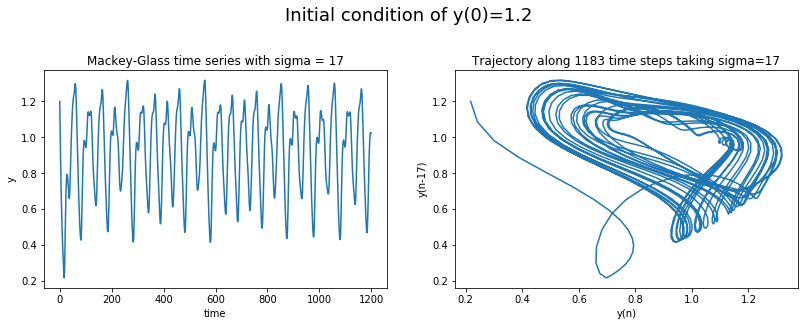

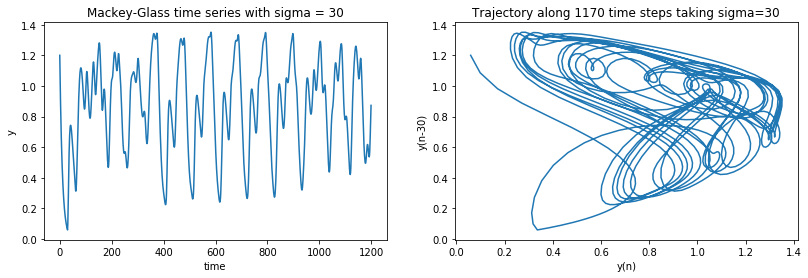

In [3]:
visualize_MG(sigmas=[17, 30])

Let us now consider a non-chaotic case. Take, for instance, $\sigma=5$ and $\sigma=10$. By looking at the below images, we see a stable periodic orbit in both cases.

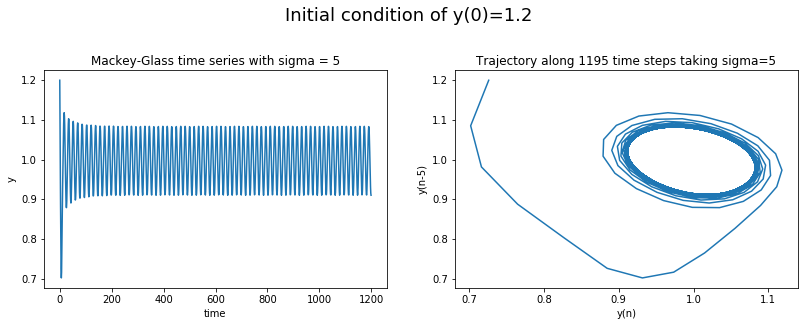

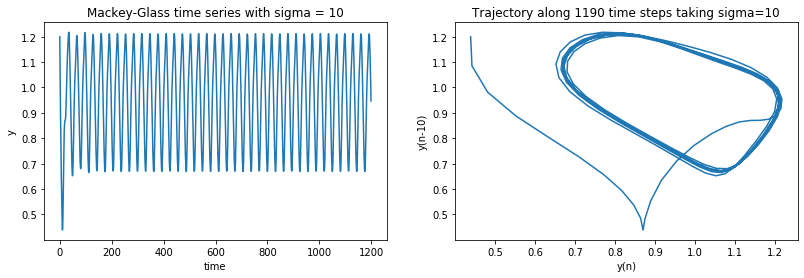

In [4]:
visualize_MG(sigmas=[5, 10])

Now, we will come back to the chaotic parameters but we are going to set another initial condition.

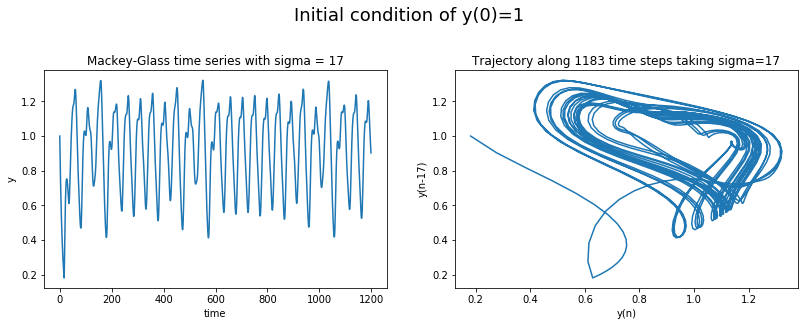

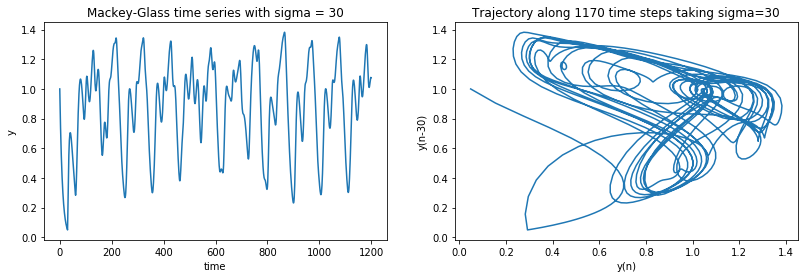

In [5]:
visualize_MG(sigmas=[17, 30], cond_in = 1)

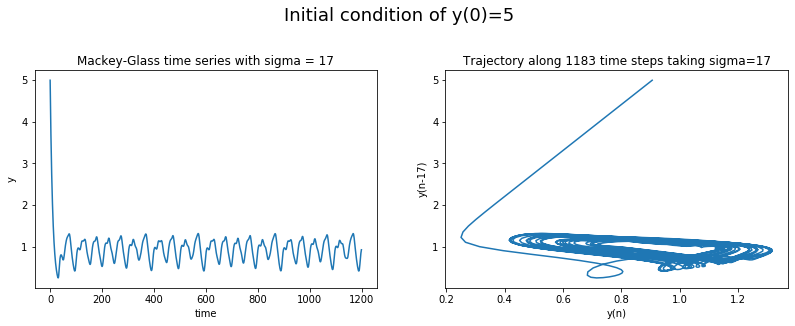

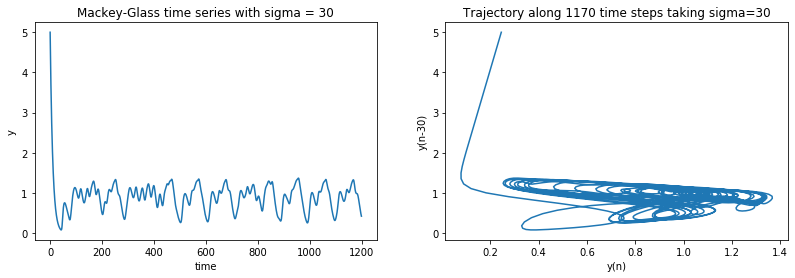

In [6]:
visualize_MG(sigmas=[17, 30], cond_in = 5)

# 2. Setting the task and definition of the main class <a name="Setting"></a>

Along the notebook, we are going to train an echo states network so as to learn the dynamics given by the Mackey-Glass system. By "learning the dynamics" we mean training the network for a sequence of a certain size $T$ in such a way that the trained network could afterwards reproduce the training sequence for $t>T'$, where $T'<<T$. Observe that, for $T'<t<T$, the network would reproduce data already seen during training whereas, for $t>T$, the network would predict unseen data. Therefore, the main goal of the task would be to reproduce the dynamics of the training sequence as well as predicting the maximum number of time steps after training.

As stated in [Section 1](#MackeyGlass_System), the Mackey-Glass is a continuous dynamical system that is going to be discretized as follows

\begin{equation}\label{17_3000}\tag{1}
y_\text{teach}(n+1)=y(n)+\delta\left[\frac{0.2\, y(n-\frac{\sigma}{\delta})}{1+y(n-\frac{\sigma}{\delta})^{10}}-0.1\, y(n)\right],
\end{equation}

with $\delta = 1/10$ and $\sigma$ being the delay. Afterwards, a subsampling by 10 is going to be performed. Since the activation function is going to be a tanh, we want our sequence to take values in the interval [-1,1].  That is the reason why such sequences will undergo the following transformation

$$
y_\text{teach}\rightarrow \tanh(y_\text{teach}-1).
$$

Therefore, unless we specify the contrary, $y_\text{teach}$ is going to denote such squashed version of the trajectory. 

Notice that, in order to compute $y^\text{teach}(n)$ in equation (\ref{17_3000}), it is needed to know $y^\text{teach}(n-1)$ and $y^\text{teach}(n-10\sigma)$. By default, we are going to take $y^\text{teach}(0)=1.2$ and $y^\text{teach}(n)=0$ for $n<0$ since it is the more standard choice. However, we are also performing experiments modifying the initial condition.

Now that we have already defined the dynamics of the training sequences, let us now go into the details of the network. The parameters of the network are going to be:

* $W^\text{in}\in M_{N\times 1}(\mathbb{R})$
* $W\in M_{N\times N}(\mathbb{R})$
* $W^\text{back}\in M_{N\times 1}(\mathbb{R})$
* $W^\text{out}\in M_{1\times N}(\mathbb{R})$, which has to be learnt
* $u(n)\in M_{1\times 1}(\mathbb{R})$ for all $n$
* $y^\text{teach}\in M_{1\times T}(\mathbb{R})$
* $y(n)\in M_{1\times 1}(\mathbb{R})$ for all $n$
* $\nu(n)\in M_{N\times 1}(\mathbb{R})$ for all $n$

where $N$ is the number of nodes of the reservoir, $T$ the number of training time steps and $\nu$ is going to be some noise. See the training explanation below in order to see the details of the noise.

In our case of study, we will deal with a reservoir composed by 400 nodes. Such nodes are going to be randomly connected taking weights equal to 0, 0.4 and -0.4 with probabilities 0.9875, 0.00625 and 0.00625 respectively. Therefore, we will only regard 1.25% of connections. Finally, such weights are going to be rescaled in order to obtain an adjacency matrix with an spectral radius of 0.79.

It is clear that our network needs to have feedback weights in order to get the information from previous outputs. Such connections ($W^\text{back}$) are going to be randomly sampled following a uniform distribution over [-0.56,0.56]. In addition, we are going to consider a constant input equal to 0.2, that is, $u(n)=0.2$ for all $n$ in order to introduce more variability within the internal states. The matrix giving the input connections ($W^\text{in}$) will be randomly chosen from the set {0, 0.14, -0.14} with probabilities 0.5, 0.25 and 0.25 respectively.

Let us now go into the details of the training and testing procedures.

${\small \text{  }}$




${\underline{\small \text{TRAINING}}}$

As stated above, the task is to learn the dynamics of the Mackey-Glass system. In order to achieve so, different experiments are going to be carried out, each one considering a different type of training sequence: 
* $\sigma = 17$ and $T=3000$ time steps.
* $\sigma = 17$ and $T=21000$ time steps.
* $\sigma = 30$ and $T=3000$ time steps.
* $\sigma = 30$ and $T=21000$ time steps. 

Recall that $\sigma$ is the parameter determining the degree of chaos, being 16.8 the boundary over which the system becomes chaotic. Therefore, $\sigma = 17$ entails a mildly chaotic system whereas $\sigma = 30$ entails a wilder chaotic system.

[Section 3](#Delay17) and [Section 4](#Delay30) show the training and testing of the network by using a delay of $\sigma=17$ and $\sigma=30$ respectively. In each of these sections, we perform a lot of experiments so as to get an intuition, and eventually understand, how the learning is carried out. Finally, [Section 5](#MackeyGlass_VaryDelay) analyzes the training and testing of the network for values of $\theta$ between 17 and 30.

Let us now provide the training formulas.

The update of the reservoir is going to be performed by means of teacher forcing as follows:

$$
x(n+1) = (1-\delta Ca)x(n)+\delta C\left[ \tanh\left( W^\text{in}u(n+1)+Wx(n)+W^\text{back}y^\text{teach}(n) + \nu(n) \right) \right],
$$

where we are going to take $\delta=1$, $C=0.49$ and $a=0.9$. The reservoir will be initialized with zero starting state. The noise $\nu(n)$, which will be uniformly sampled from the interval $[-0.00001,0.00001]^{400}$, will only be introduced when dealing with $\sigma=30$, since, as we are going to see, it entails a more stable result. On the other hand, no noise will be required when dealing with $\sigma=17$.

The output of the network will be a linear combination of the internal states of the reservoir. That is, the output will be computed as

$$
y(n) = W^\text{out}x(n),
$$

where $W^\text{out}\in M_{1\times N}(\mathbb{R})$ is the matrix to be learnt. 

The learning is carried out by minimizing the MSE, which is 

$$
\text{MSE} = \frac{1}{T-n_\text{min}}\sum_{n=n_\text{min}}^T\left[ \tanh^{-1}\left(y^\text{teach}(n)\right)-W^\text{out}x(n) \right]^2,
$$

where $T$ is the the number of training time steps and $n_\text{min}$ is the number of discarded time steps.

${\small \text{  }}$




${\underline{\small \text{TESTING}}}$

When testing the network, the update will depend on the output produced by the network itself:

$$
\begin{align*}
x(n+1)&=(1-\delta Ca)x(n)+\delta C\tanh\left(W^\text{in}u(n) + Wx(n)+W^\text{back}y(n)\right)\\
y(n+1)&=\tanh\left(W^\text{out}x(n+1)\right)
\end{align*}.
$$

However, before letting the network freely run, we need to perform a few time steps of teacher forcing in order to let the internal states of the reservoir converge. In the function we are going to implement in order to perform the testing, there is a parameter called *t_dismiss*, that specifies the number of teacher forcing steps and, then, *t_autonom*, which gives the number of time steps the network is going to freely run.

In order to check whether the network has approppriately learnt the dynamics, we are going to check different aspects. As stated above, let $T$ be the number of training time steps. Then:

* We are going to consider different values of *t_autonom* all lower than $T$. Then, we will see how many time steps the network is able to "predict". We say "predict" (within quotation marks) since such time steps will have already been seen by the network while training. 

* We are going to consider *t_autonom=T*. Then, we will analyze the prediction capability of the trained network. Notice that, in these type of experiments, the network will predict time steps not seen while training.

In both cases, we are going to analyze not only the accuracy of the prediction (by means of the MSE) but also whether the network has learnt the dynamics (by means of visual inspection of both types of plots). **In addition, we are also going to introduce another metrics, which is the so called *normalized root mean square error (NRMSE)* for a certain *horizon*.** A very common choice is an horizon of 84 time steps, denoted as $\text{NRMSE}_{84}$. In order to compute it, we will perform 50 subsequent runs of 1084 time steps each. The first 1000 steps will be done by means of teacher forcing and, the following 84 will be carried out by letting the network freely run. In other words,
* The reservoir is updated by means of teacher forcing for 1000 time steps.
* The network autonomously runs for another 84 time steps. The value y(1000+84) is kept.
* At this point, the reservoir is updated by means of teacher forcing for the following 1000 time steps.
* The network autonomously runs for the next 84 time steps. The value y(1000+84+1000+84) is kept.
* The previous procedure is performed 50 times. Therefore, we end up with 50 values: $\{y(n\cdot 1000 + n\cdot 84)|n=1,2,...,50\}$. 
* Then, we revert the previous shifting and squashing transformation in order to recover the original values. That is, 

 \begin{align}
 y(n\cdot 1000 + n\cdot 84) &\rightarrow \text{arctanh}(y(n\cdot 1000 + n\cdot 84))+1 \\
 y^\text{teach}(n\cdot 1000 + n\cdot 84) &\rightarrow \text{arctanh}(y^\text{teach}(n\cdot 1000 + n\cdot 84))+1
 \end{align}

 for $n=1,2,...,20$. 
* Finally, the NRMSE is computed by means of the already recovered original values as follows

 $$
 \text{NRMSE}_{84} = \left(\frac{\sum_{n=1}^{50} \left[y(n\cdot 1000 + n\cdot 84)-y^\text{teach}(n\cdot 1000 +   n\cdot 84)\right]^2}{50\,\sigma^2}\right)^\frac{1}{2},
 $$

 where $\sigma^2$ is the variance of the original signal. 

*Observation*: $\sigma^2$ is computed from the original values as follows

$$
\sigma^2 = \text{E}\left[\left(y^\text{teach}\right)^2\right]-\text{E}\left[y^\text{teach}\right]^2,
$$

where the expectation is empirically approximated by the mean.


**Notice that the $\boldsymbol{\textbf{NRMSE}_{84}}$ ONLY depends on the trained network.**


Let us now provide, in the following two cells, all the the packages required and the class *Network*, which is going to be used to perform all the steps of the learning process.

In [ ]:
#restart the kernel
import os
os._exit(00)

In [1]:
import numpy as np
import random
import matplotlib.pyplot as plt
import scipy.linalg
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

In [2]:
def esc(code):
    return f'\033[{code}m'

In [3]:
class Network():
    def __init__(self, T = None, n_min = None, K = None, N = None, L = None, W_in = None, W = None, W_back = None,
                 non_null_matrices = None, u = None, sigma = None, InitialCondition_ODE = None, delta = None,
                C = None, a = None):

        #NEED TO BE DEFINED BY THE USER:
        self.T = T #number of training time steps (integer)
        self.n_min = n_min #time steps dismissed (integer)
        
        self.K = K #dimension of the input (integer) (may be None)
        self.N = N #dimension of the reservoir, i.e, number of nodes (integer)
        self.L = L #dimension of the output (integer)
        
        self.W_in = W_in #input connections (matrix of size self.N x self.K) (may be None)
        self.W = W #adjacency matrix (matrix of size self.N x self.N)
        self.W_back = W_back #feedback connections (matrix of size self.N x self.L) (may be None)
        
        self.non_null_matrices = non_null_matrices #list giving the matrices used when training: "W_in" and/or "W_back"
        
        self.u = u #input (matrix of size self.K x 1) (may be None)               
        
        self.sigma = sigma #delay of the ODE (float)
        self.InitialCondition_ODE = InitialCondition_ODE #initial condition of the ODE (list with the float)
        
        self.delta = delta #training parameter (float)
        self.C = C #training parameter (float)
        self.a = a #training parameter (float)
                
        
        #DO NOT NEED TO BE DEFINED BY THE USER:
        self.initial_state = None #initial state of the reservoir (state forgetting property)        
        self.trajectories = None #dynamics of the reservoir (matrix of size self.T x self.N) 
        self.regressor = None #regressor
        self.y_teach = None #desired output of the network (matrix of size self.L x self.T)
        self.y_teach_test = None #y_teach for doing the test (matrix of size self.L x (t_dismiss+t_autonom)) 
        

    def orbit(self, ic, sigma, t, squash=False):
        """
        Args:
            -ic, list giving the initial condition [y(0)]
            -sigma, value of the sigma param (delay of the ODE)
            -t, number of time steps
            -squash, whether we want to squash the orbits into [-1,1]
        
        Returns:
            -Matrix of size 1xt given the orbit followed by the given initial point during t time steps. 
            The first column gives the initial condition. The orbit is squashed into [-1,1] if squash=True.
        """
        
        total_time_steps = 10*t+int(sigma/0.1)
        orbit_aux = np.zeros(total_time_steps)
        orbit_aux[int(sigma/0.1)] = ic[0]
        for n in np.arange(int(sigma/0.1), total_time_steps-1):
            orbit_aux[n+1] = orbit_aux[n]+0.1*((0.2*orbit_aux[n-int(sigma/0.1)])/(1+orbit_aux[n-int(sigma/0.1)]**10)-0.1*orbit_aux[n])
        
        #subsample
        orbit_wanted = orbit_aux[int(sigma/0.1):]
        orbit_wanted = orbit_wanted[0:len(orbit_wanted):10]
        
        if squash == True:
            orbit_wanted = np.tanh(orbit_wanted-1).reshape((len(ic),t))
                        
        return orbit_wanted
    
        
    
    def dismiss_transient(self, M):
        """
        Given a matrix M, it removes the first n_min rows. Therefore:
        -If M = self.trajectories, it removes the transient of n_min.
        -If M = self.y_teach.T, it removes the transient of n_min.
        So, it removes the initial condition plus the following n_min-1 time steps
        NOTICE: y_teach has to be transposed when inputted
        """
        
        return M[self.n_min:,:]
        
    
    
    def compute_nodes_trajectories(self, test=False, noise=None, boundary_noise=None, t_dismiss=None, t_autonom=None, NRMSE=False, horizon=None, num_runs=None): 
        """
        If test=False:
            -It computes self.trajectories, which is a matrix of size TxN, where each column is the trajectory of 
            a node. Notice that the first row corresponds to the initial state
            -It admits noise, in which case the boundary_noise has to be specified
        
        If test=True and NRMSE=False:
            -Computes the predictions for the desired t_autonom regarding a teacher forcing of t_dismiss time steps
        
        If test=True and NRMSE=True:
            -It computes the predictions at the desired time steps. That is, the network runs from the initial
            conditions for 1000 time steps by means of teacher forcing. Then, it autonomoulsy runs the number of
            steps specified in the variable horizon. This is repeated num_runs time.
            Therefore, it return the predictions at time steps [i*(1000+horizon)-1 for i in np.arange(1,num_runs+1)]
        """
        
        #initial state of the reservoir
        if test == False:
            self.trajectories = self.initial_state
            x_prev = self.initial_state  
        if test == True:
            if NRMSE == False:
                x_prev = self.trajectories[t_dismiss-1,:]
            elif NRMSE == True:
                x_prev = self.initial_state
           
                
        if test == False:             
            if noise == True:
                nu = np.random.uniform(low=-boundary_noise, high=boundary_noise, size=(self.N, self.T))
            elif noise == False:
                nu = np.zeros([self.N, self.T])                
        
        if "W_in" not in self.non_null_matrices:
            self.W_in = np.zeros([self.N, 1])
            if test == False:
                self.u = np.zeros([1, 1])            
            
        if "W_back" not in self.non_null_matrices:
            self.W_back = np.zeros([self.N, 1])
            if test == False:
                y = np.zeros([1, self.T]) 
            elif test == True:
                if NRMSE == False:
                    y = np.zeros([1, self.T+t_autonom])
                elif NRMSE == True:
                    y = np.zeros([1, self.T+t_autonom])
            
        if "W_back" in self.non_null_matrices:
            if test == False:
                y = np.copy(self.y_teach)
            elif test == True:
                if NRMSE == False:
                    y = self.y_teach_test[:,t_dismiss-1].reshape(-1,1)        
        
               

        delta = self.delta
        C = self.C
        a = self.a
        
        
        if test == False:
            for n in np.arange(self.T-1):
                x = (1-delta*C*a)*x_prev + delta*C*np.tanh(np.dot(self.W_in,self.u[:,0])+np.dot(self.W,x_prev)+np.dot(self.W_back,y[:,n])+nu[:,n])
                self.trajectories = np.vstack((self.trajectories,x))
                x_prev = x           
            return self
        
        elif test == True:
            if NRMSE == False:
                for n in np.arange(t_autonom):
                    x = (1-delta*C*a)*x_prev + delta*C*np.tanh(np.dot(self.W_in, self.u[:,0])+np.dot(self.W,x_prev)+np.dot(self.W_back,y[:,n]))
                    x_prev = x
                    y_next = np.tanh(self.regressor.predict(x.reshape(1,-1)))
                    y_next = y_next.reshape(-1,1)
                    y = np.hstack([y,y_next])                    
                return y  
            
            elif NRMSE == True:
                y = np.zeros([self.L,1]) #this is just for initializing the hstack. It will be removed at the end
                for run in np.arange(num_runs):
                    
                    #teacher forcing
                    for n in np.arange(1000):
                        x = (1-delta*C*a)*x_prev + delta*C*np.tanh(np.dot(self.W_in, self.u[:,0])+np.dot(self.W,x_prev)+np.dot(self.W_back,self.y_teach_test[:,(run*(1000+horizon))+n]))
                        x_prev = x
                        
                        
                    #autonomously run
                    for n in np.arange(horizon):
                        y_next = np.tanh(self.regressor.predict(x.reshape(1,-1)))
                        y_next = np.asarray(y_next).reshape(-1)
                        x = (1-delta*C*a)*x_prev + delta*C*np.tanh(np.dot(self.W_in, self.u[:,0])+np.dot(self.W,x_prev)+np.dot(self.W_back,y_next))
                        x_prev = x
                    y_next = y_next.reshape(-1,1)                        
                    y = np.hstack([y,y_next])
                    
                return y[:,1:]
            
            
    
    
    def plot_nodes_trajectories(self, sel_nodes=False, num_nodes=10):
        """
        Args:
            -sel_nodes, list specifying the nodes of the reservoir to be plotted. If sel_nodes=False, it randomly
            selects num_nodes nodes of the reservoir.
        
        Returns:
            -Plots the trajectories of the given nodes.
        """
        
        if sel_nodes == False:
            nodes_to_plot = random.sample(range(self.N),num_nodes) #select num_nodes random nodes
        else:
            nodes_to_plot = sel_nodes
        
        t = np.arange(self.T) #time steps
        for node in nodes_to_plot:
            plt.plot(t, self.trajectories[:,node])  
            plt.title("Trajectories of the node {}".format(node))
            plt.show()
            
            
    def train_network(self, plot=False, noise=False, boundary_noise=0.00001):
        """
        Args:
            -plot, whether we want to plot the trajectories of 10 randomly selected nodes of the reservoir
            -noise, whether we want to add noise when training
            -boundary noise, if noise=True and boundary_noise=a, then the noise is going to be uniformly 
            distributed on the interval [-a,a]
        
        Returns:
            -Performs the training and returns the object self. It computes self.trajectories, self.regressor and
            prints the training MSE component-wise.
        """
        
        #Define the initial state (which is not relevant due to state forgetting property)
        #Define the ground truth
        self.initial_state = np.zeros(self.N)
        self.y_teach = self.orbit(self.InitialCondition_ODE, self.sigma, self.T, squash=True)  
        
        
        #Compute trajectories
        self.compute_nodes_trajectories(noise=noise, boundary_noise=boundary_noise)

        #plot some trajectories
        if plot == True:
            self.plot_nodes_trajectories()
            
        regressor = LinearRegression()
        regressor.fit(self.dismiss_transient(self.trajectories), np.arctanh(self.dismiss_transient(self.y_teach.T)))
        
        #Compute MSE
        MSE_vector = 1/(self.T-self.n_min)*sum((np.arctanh(self.dismiss_transient(self.y_teach.T)) - regressor.predict(self.dismiss_transient(self.trajectories)))**2)
        
        if self.L == 1: #in case the output is one dimensional
            print("The training MSE is {}".format(MSE_vector[0]))        
        else: #in case the output has dimension 2 or more
            for i in np.arange(self.L):
                print("The training MSE for the {}-th dimension is {}".format(i+1, MSE_vector[i]))        
                                              
        self.regressor = regressor   
        
        return self   
    
    
    
    def test_network(self, t_dismiss, t_autonom, NRMSE=True):
        """
        Args:
            -t_dismiss, which is the time we let the reservoir evolve by teacher forcing.
            -t_autonom, which is the time we let the network freely run  
            -NRMSE, which says whether we want to compute the 84 NRMSE error
        
        Returns:
            -The MSE and NRMSE (whenever NRMSE=True) during the t_autonom component-wise
            -Plots the predicted trajectory during the t_autonom against the ground truth.
        """  
        
        #Define y_teach_test
        self.y_teach_test = self.orbit(self.InitialCondition_ODE, self.sigma, t_dismiss+t_autonom, squash=True)
            
                      
        #predict
        y = self.compute_nodes_trajectories(test=True, t_dismiss=t_dismiss, t_autonom=t_autonom)
        y = y[:,1:] #remove the first one
        
        
        ##############
        #plot outputs
        ##############
        plt.figure(figsize=(20,7))
        plt.plot(self.y_teach_test[0, t_dismiss:], label="Desired output (y_teach)")
        plt.plot(y[0,:], '--',linewidth=1.0, label="Network's prediction")
        plt.title("Prediction on testing time: time series")
        plt.legend(loc='upper right')
        plt.xlabel('Time step n')
        plt.ylabel('Chaotic position y(n)')
        
        fig, axs = plt.subplots(1, 2, figsize=(13.5, 4))
        axs[0].plot(self.y_teach_test[0, t_dismiss+self.sigma:], self.y_teach_test[0,t_dismiss:len(self.y_teach_test[0])-self.sigma])  
        axs[0].set_title("Ground truth")
        axs[0].set(xlabel="y-teach(n)", ylabel="y-teach(n-{})".format(self.sigma))
        GT, = axs[1].plot(self.y_teach_test[0, t_dismiss+self.sigma:], self.y_teach_test[0,t_dismiss:len(self.y_teach_test[0])-self.sigma])  
        Pred, = axs[1].plot(y[0,self.sigma:], y[0,:len(y[0,:])-self.sigma]) 
        axs[1].set_title("Network's prediction vs Ground truth")
        axs[1].set(xlabel="y(n)", ylabel="y(n-{})".format(self.sigma))  
        plt.legend([GT, Pred],["Ground truth", "Network's prediction"])
        
        plt.show()
        

        #MSE 
        MSE = 1/t_autonom*sum((self.y_teach_test[:,t_dismiss:t_dismiss+t_autonom]-y).T**2) 
        
        if self.L == 1: #in case the output is one dimensional
            print("The test MSE is {}".format(MSE[0]))        
        else: #in case the output has dimension 2 or more
            for i in np.arange(self.L):
                print("The test MSE for the {}-th dimension is {}".format(i+1, MSE[i]))        
           

        #NRMSE
        if NRMSE == True:
            NRMSE = self.compute_NRMSE()
            
            if self.L == 1: #in case the output is one dimensional
                print("The 84 NRMSE is {}".format(NRMSE[0]))        
            else: #in case the output has dimension 2 or more
                for i in np.arange(self.L):
                    print("The 84 NRMSE for the {}-th dimension is {}".format(i+1, NRMSE[i]))
                                 
        
                
                
    def compute_NRMSE(self, horizon=84, num_runs=50):
        """
        Computes the 84 NRMSE component-wise for the given horizon (specified in the parameter horizon) and for
        the given number of runs (specified in the parameter num_runs).
        """
        
        #Redefine the self.y_teach_test. It will be of size 2x(1048x50) 
        self.y_teach_test = self.orbit(self.InitialCondition_ODE, self.sigma, (1000+horizon)*num_runs, squash=True)
        var = []
        for i in np.arange(self.L):
            #variance of i-th component
            var.append(np.average(self.y_teach_test[i,:]**2)-np.average(self.y_teach_test[i,:])**2) 
            
        
        #desired predictions at the required time steps
        y = self.compute_nodes_trajectories(test=True, NRMSE=True, horizon=horizon, num_runs=num_runs)
        
        #Compute the NRMSE
        list_cols = [i*(1000+horizon)-1 for i in np.arange(1,num_runs+1)]
        y_ground_truth = self.y_teach_test[:, list_cols] 
        y_ground_truth = np.arctanh(y_ground_truth)+1 #recover original values
        y = np.arctanh(y)+1 #recover original values
        
        NRMSE = []
        for i in np.arange(self.L):
            NRMSE.append((sum((y_ground_truth[i,:]-y[i,:])**2)/var[i])**0.5)
        
        return NRMSE  
    
    
    

    
    def train_test_init_cond(self, ic_list, test_time, NRMSE=True, noise=False):
        """
        Performs the training and testing for the initial conditions stored in the LIST ic_list.
        The trainig is performed with noise (with the default value of noise) whenever noise=True.
        The testing is done for t_dismiss=self.T and t_autonom=test_time.
        This function works as long as the self object is initialized and its attributes are already defined.
        It only returns the NRMSE_84 in case NRMSE=True
        """
        for ic in ic_list:
        
            #set initial condition
            self.InitialCondition_ODE = [ic]
                
            print(esc(0))
            print(esc('31;1;4') + 'Initial condition y(0)={}'.format(ic))
            print(esc(0))
                
            #training
            if noise == False:
                self.train_network(plot=False)
            elif noise == True:
                self.train_network(plot=False, noise=True)
        
            #testing
            self.test_network(t_dismiss=self.T, t_autonom=test_time, NRMSE=NRMSE) 
        

In [4]:
#Initialize instance
Network = Network()

In [5]:
#############
#Parameters of the network
#############
Network.K = 1
Network.N = 400
Network.L = 1
Network.W_in = np.random.choice([0,0.14,-0.14], Network.N, p=[0.5, 0.25, 0.25]).reshape((Network.N,Network.K))
Network.W_back = np.random.uniform(low=-0.56, high=0.56, size=Network.N).reshape((Network.N,Network.L))
Network.non_null_matrices = ["W_back", "W_in"]
Network.u = 0.2*np.ones([Network.K,1])

#############
#Reservoir
#############
Network.W = np.random.choice([0,0.4,-0.4], Network.N*Network.N, p=[0.9875, 0.00625, 0.00625]) #adjacency matrix
Network.W = Network.W.reshape((Network.N, Network.N))

#rescale Network.W
alpha = 0.79/max(abs(scipy.linalg.eigvals(Network.W)))
Network.W = alpha*Network.W
print("The maximum eigenvalue (in module) is {}".format(max(abs(scipy.linalg.eigvals(Network.W)))))
_,s,_ = scipy.linalg.svd(Network.W)

The maximum eigenvalue (in module) is 0.7900000000000009


# 3. Training the network taking a delay of $\sigma = 17$ <a name="Delay17"></a>

In all this section we are going to regard a training sequence with $\sigma = 17$, which renders a mildly chaotic system. Such sequences are going to be of size T=3000 in [Section 3.1](#Delay17_3000) and size T=21000 in [Section 3.2](#Delay17_21000). In both cases, we will begin by dealing with the default value of the initial condition, which is $y_\text{teach}(0)=1.2$ and, afterwards, we will change it and see what happens. A comparison of all the results found within these two sections can be found in [Section 3.3](#Delay17_Comparison). Finally, in [Section 3.4](#Delay17_Capacity), we increase the network's capacity in order to check whether we can increase its capability prediction.

The task details were already stated in [Section 2](#Setting).

## 3.1 Training with a sequence of length  T = 3000 <a name="Delay17_3000"></a>

The training sequence will be of size T=3000 and will be constructed by taking $\sigma=17$.

In [6]:
Network.T = 3000
Network.n_min = 1000
Network.sigma = 17
Network.InitialCondition_ODE = [1.2]
Network.delta = 1
Network.C = 0.44
Network.a = 0.9

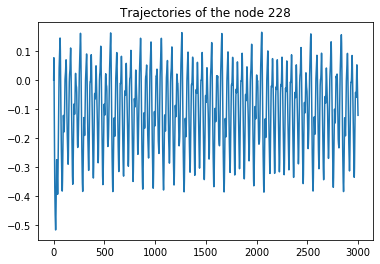

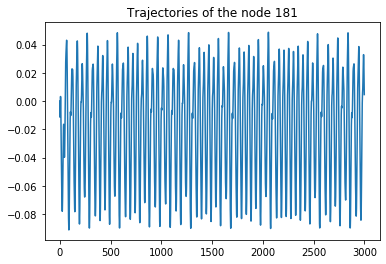

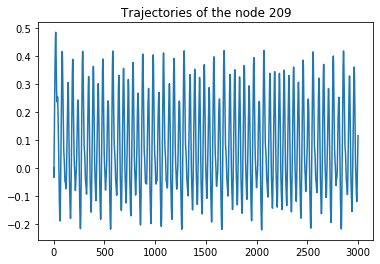

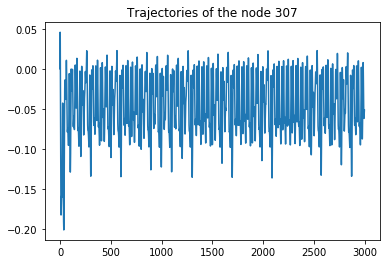

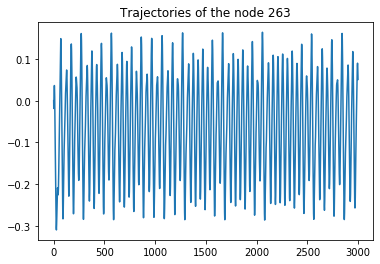

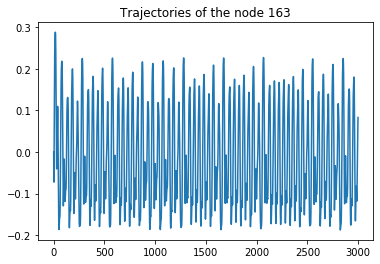

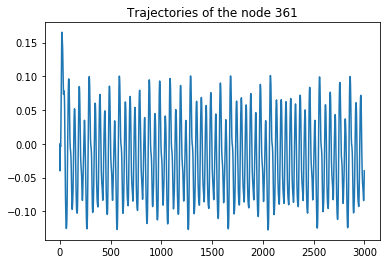

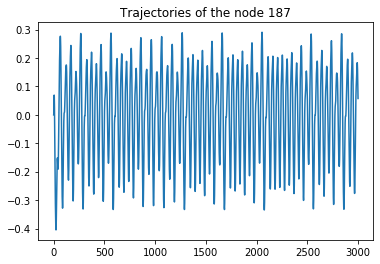

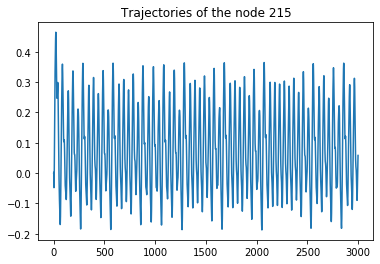

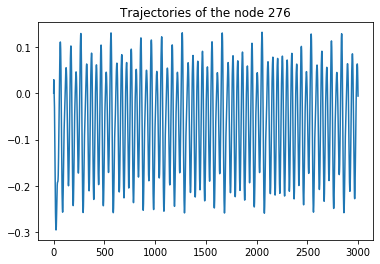

The training MSE is 1.4139769750728818e-11


In [7]:
#TRAINING
#After the plots, the training MSE is printed
Network.train_network(plot=True)

We obtained a training MSE of around 1.41e-11 (although this value may slightly vary depending on the execution).

Let us now test the network. We are going to consider different values of the parameters *t_dismiss* and *t_autonom*. Recall that the former is the number of time steps performed by means of teacher forcing in order to let the reservoir converge whereas the latter stands for the number of time steps the network is going to freely run after the teacher forcing.

Recall that the $\text{NRMSE}_{84}$ metrics ONLY depends on the trained network. Therefore, in the following experiments, such value will always be the same. That is the reason why it will only be computed once (in the first experiment).

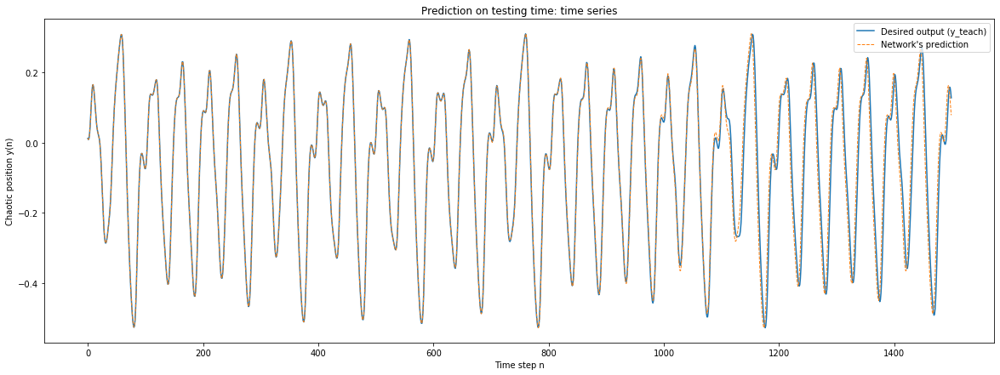

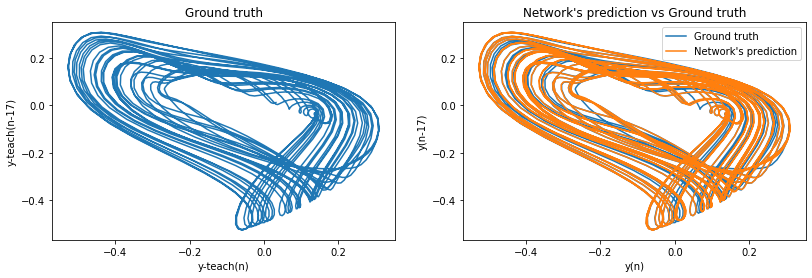

The test MSE is 0.0012077674498960104
The 84 NRMSE is 0.0010946904965944962


In [8]:
Network.test_network(t_dismiss=500, t_autonom=1500)

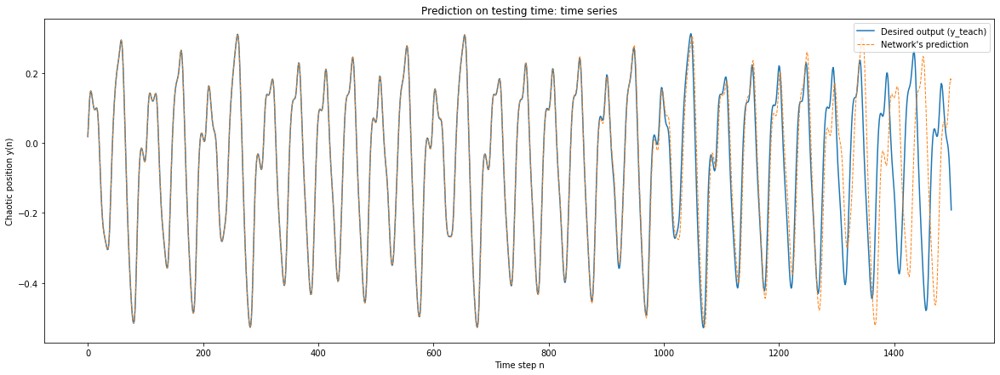

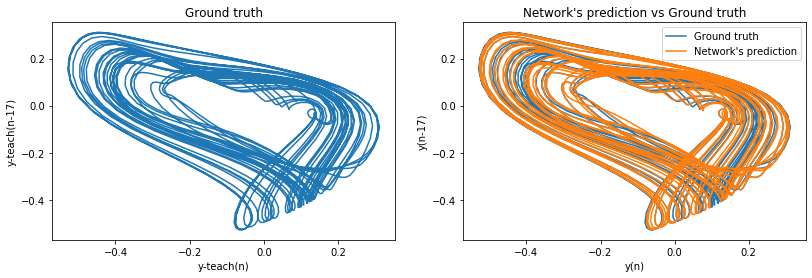

The test MSE is 0.011743020240760882


In [9]:
Network.test_network(t_dismiss=1000, t_autonom=1500, NRMSE=False)

What these two experiments illustrate is that the degree of chaos is not the same along time. For instance, we see that after performing 500 steps of teacher forcing, the prediction is quite precise. However, when 1000 steps of teacher forcing are performed, the level of chaos appears to increase after 1200, which causes the prediction to be less precise. **Notice that, in both cases, the prediction data has already been used during the training process.** 

Let us now see what happens when we predict data that has not been seen when training.

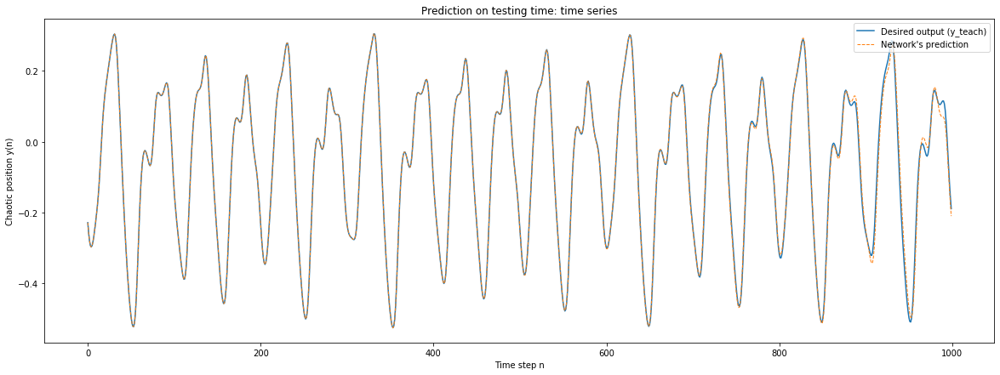

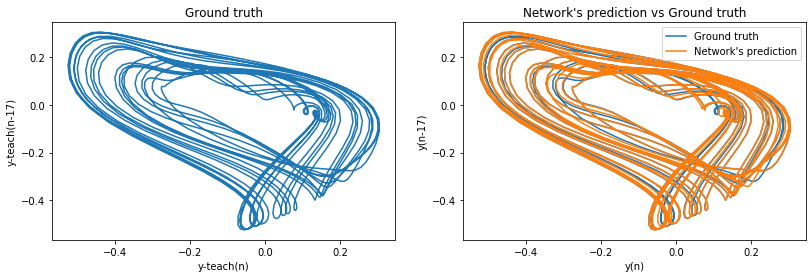

The test MSE is 0.00011545807741624359


In [10]:
Network.test_network(t_dismiss=2500, t_autonom=1000, NRMSE=False)

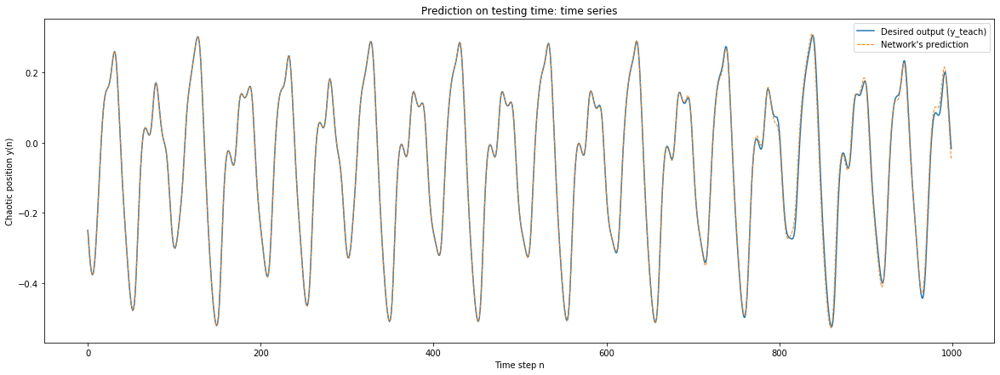

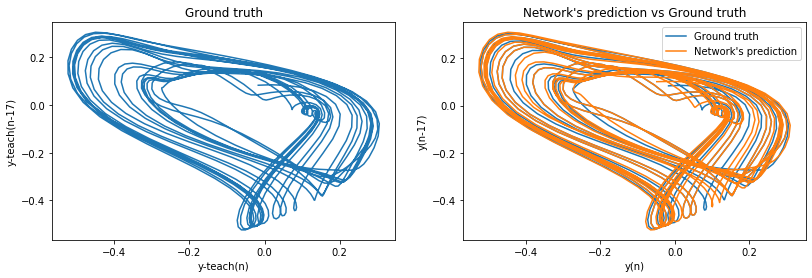

The test MSE is 0.00011956198260943113


In [11]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000, NRMSE=False)

Notice that, when *t_dismiss=2500* and *t_autonom=1000*, the first 500 predictions regard data already seen during training whereas the second 500 steps have never been seen before. On the other hand, when taking *t_dismiss=Network.T* and *t_autonom=1000* we are just predicting unseen data. Observe that in both cases the results are very good. Therefore, the network has learnt enough the dynamics in order of predicting 1000 time steps ahead.

Let us now see what happens when we increase the time the network can freely run.

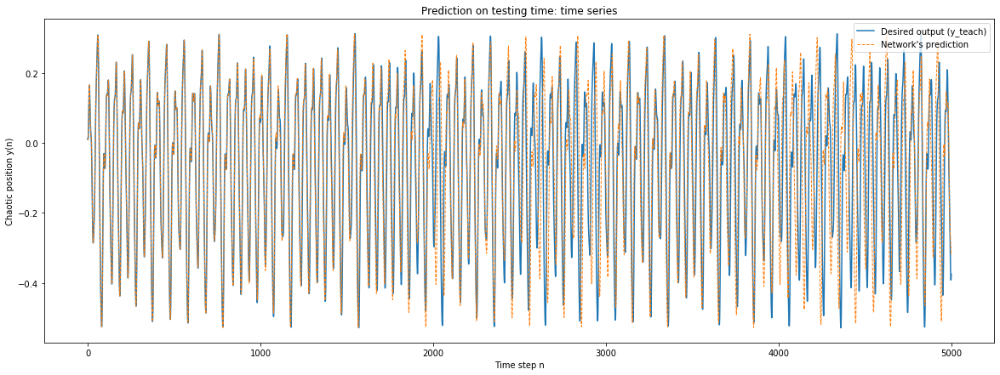

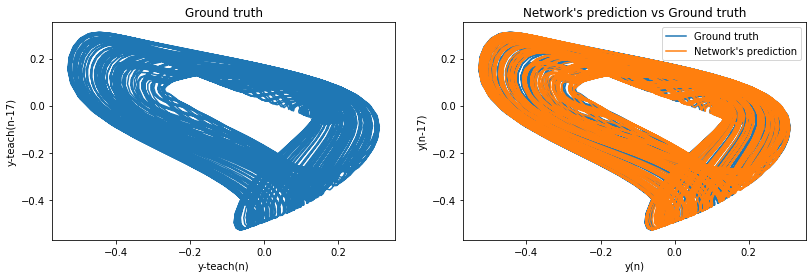

The test MSE is 0.025891455079356203


In [12]:
Network.test_network(t_dismiss=500, t_autonom=5000, NRMSE=False)

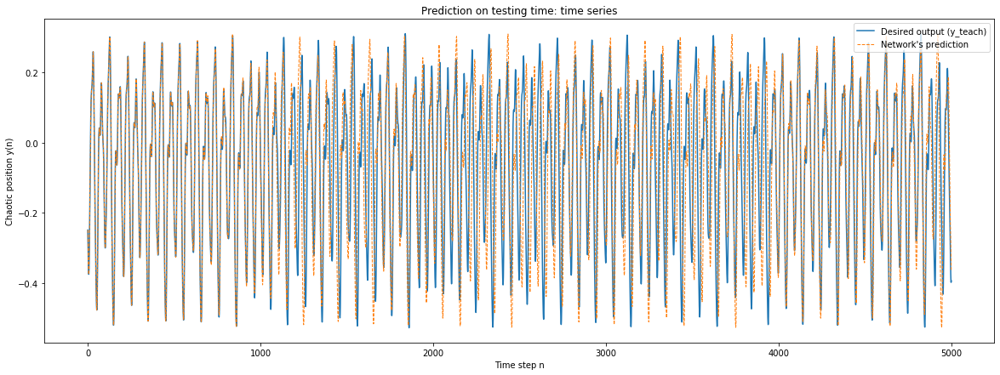

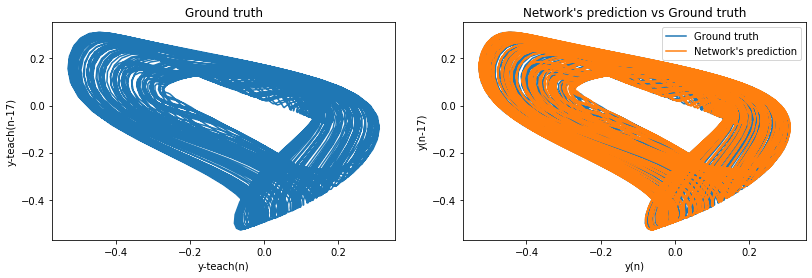

The test MSE is 0.0319151957461076


In [13]:
Network.test_network(t_dismiss=Network.T, t_autonom=5000, NRMSE=False)

In the last two experiments, the network has autonomously run for 5000 time steps after performing 500 and *Network.T* steps of teacher forcing respectively. By looking at the plots and the errors, it appears that, although the predictions may not precisely coincide with the ground truth for the 5000 points, the network has quite learnt the dynamics given by the Mackey-Glass system. This means that the prediction may degenerate for those more chaotic time steps but then it can recover precision for other less chaotic points. For instance, let us look at the time series plotted for the latter case. We can visually infer that the predictions are quite accurate for the first 1000 time steps and between 4000 and 5000 time steps, for example. On the other hand, we may say that the predictions are not that accurate around 3500.

It is clear that the network has not precisely learnt the desired dynamics at the extent of predicting 5000 time steps. However, observe that, although predictions may degenerate for some chaotic time steps, such degenerated predictions still follow a trajectory that resembles the dynamics of a Mackey-Glass system. In addition, the plots depicting (y(n),y(n-17)) also display a Mackey-Glass dynamics.

### Training and testing the network for different initial conditions 

Recall that, so far, we have considered $y_\text{teach}(0)=1.2$. Let us now see what happens if we take as initial condition 1, 1.5 or 5, for instance. In all the cases, we are going to perform *Network.T* time steps of teacher forcing. In other words, we are going to predict the next time steps after training, which is unseen data.


Initial condition y(0)=1

The training MSE is 1.1423698709912272e-11


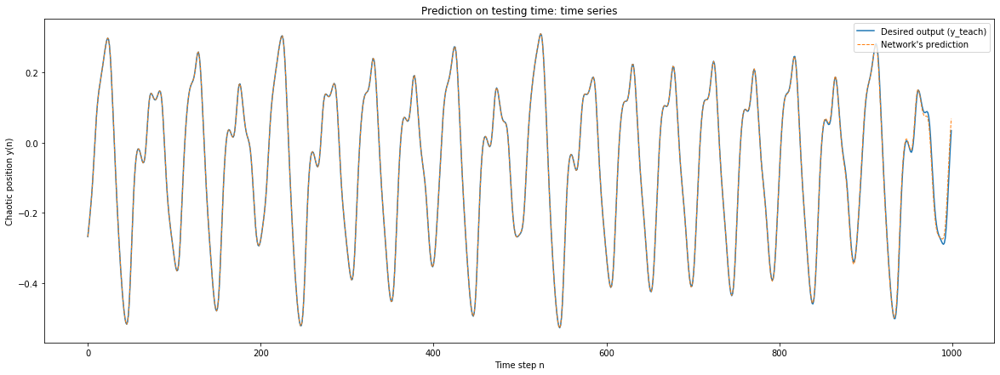

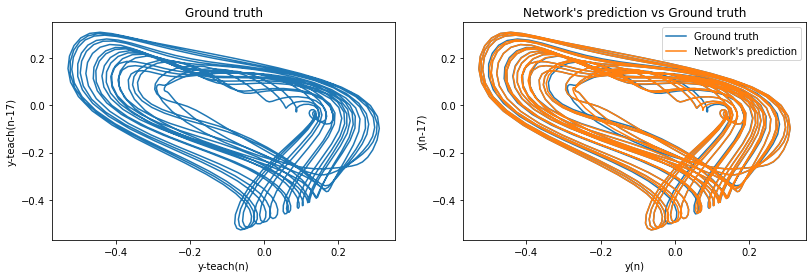

The test MSE is 3.344732438271896e-05
The 84 NRMSE is 0.002985578927604427

Initial condition y(0)=1.5

The training MSE is 1.1844015499580467e-11


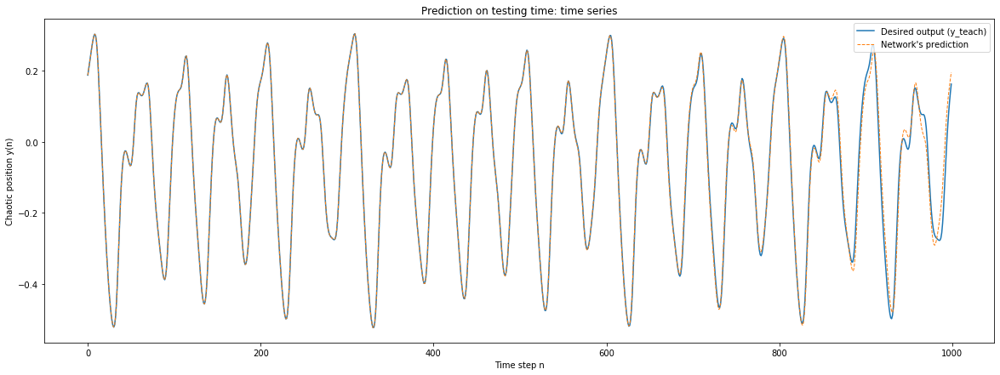

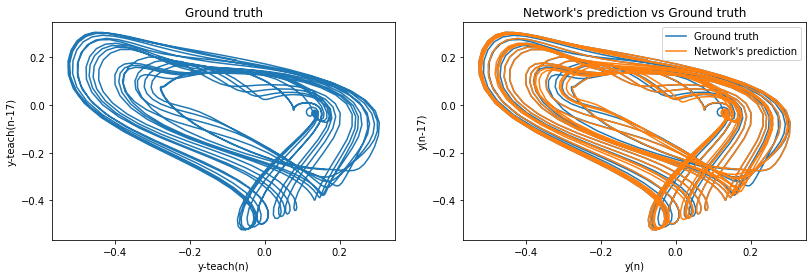

The test MSE is 0.0002893365263562941
The 84 NRMSE is 0.001048616956901539

Initial condition y(0)=5

The training MSE is 1.5350315709907296e-11


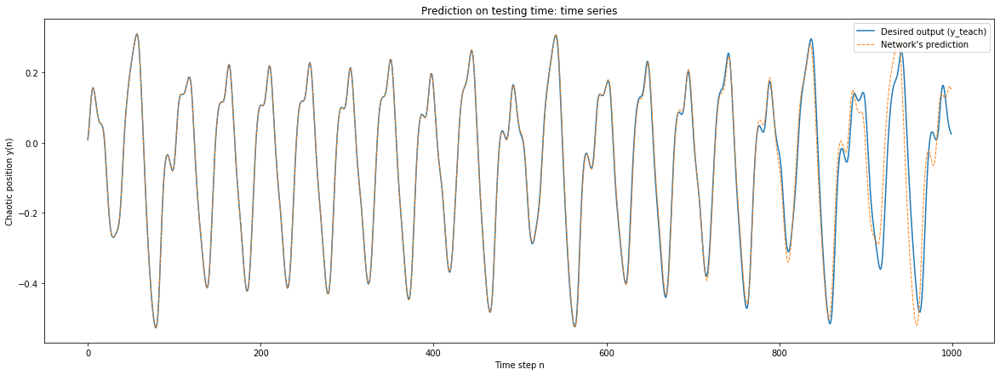

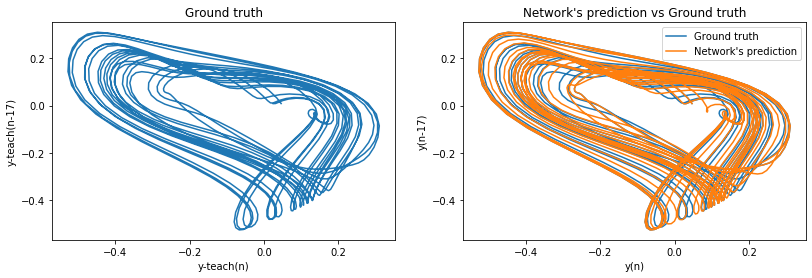

The test MSE is 0.0014516392497842159
The 84 NRMSE is 0.0015936993747896005


In [14]:
#Predict the next 1000 time steps after training
Network.train_test_init_cond([1, 1.5, 5], test_time=1000)

The predictions are very accurate, although they may degenerate in the last time steps. It is worthy noting that, despite the prediction may degenerate, it still follows a trajectory that seems to follow a Mackey-Glass dynamics. We can thus infer that the network has learnt to predict 1000 time steps ahead. 

Let us now increase the number of predictions.


Initial condition y(0)=1

The training MSE is 1.1423698709912272e-11


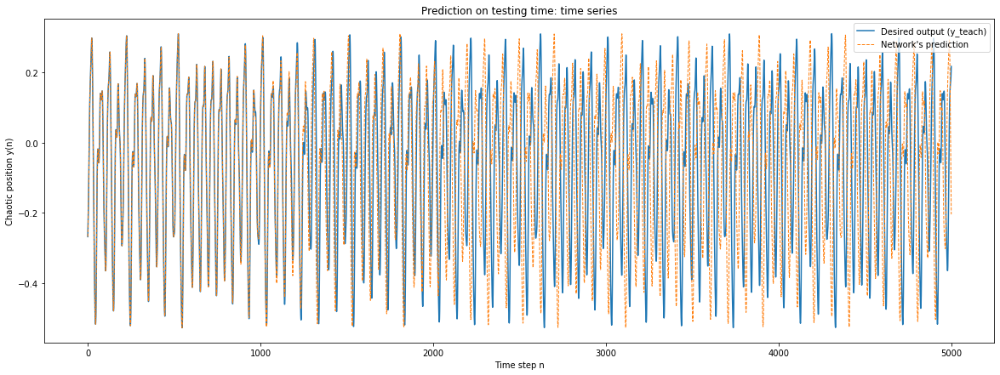

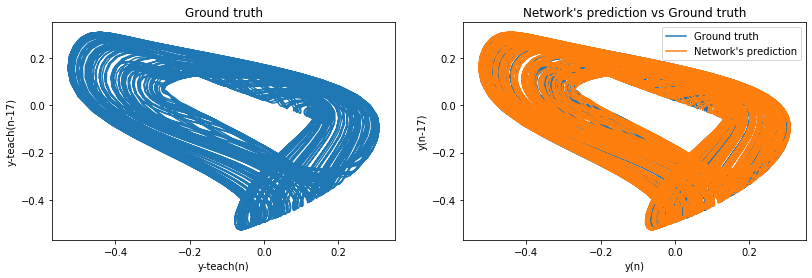

The test MSE is 0.08973043659726121
The 84 NRMSE is 0.002985578927604427

Initial condition y(0)=1.5

The training MSE is 1.1844015499580467e-11


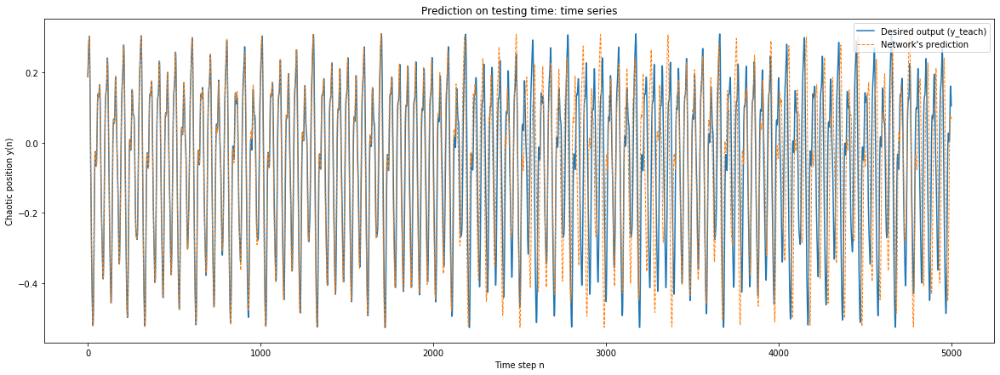

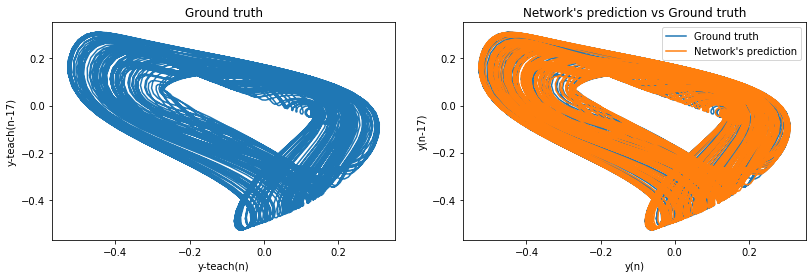

The test MSE is 0.03177011734702516
The 84 NRMSE is 0.001048616956901539

Initial condition y(0)=5

The training MSE is 1.5350315709907296e-11


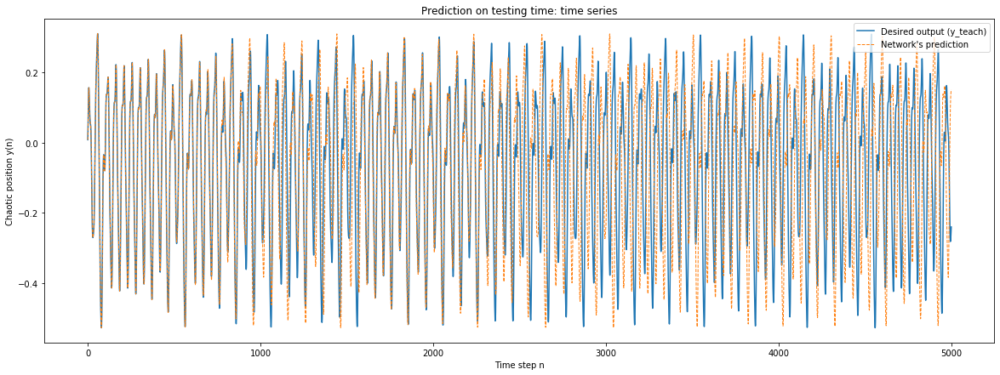

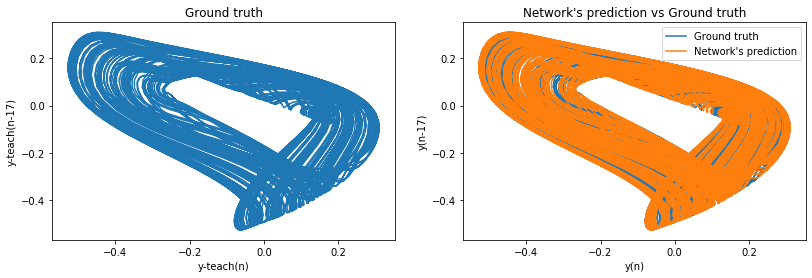

The test MSE is 0.06083143373346189
The 84 NRMSE is 0.0015936993747896005


In [15]:
#Predict the next 5000 time steps after training
Network.train_test_init_cond([1, 1.5, 5], test_time=5000)

When the number of predictions is increased until 5000, we can see that the predictions are not quite accurate for all the points. However, we can still say that the Mackey-Glass dynamics have been quite approximated. That is, predictions may degenerate when the degree of chaos is high but such degeneration still follows a dynamics that resembles that of a Mackey-Glass system. Then, if the level of chaos decreases, the degenerated prediction may recover precision by getting closer to the original trajectory. In addition, notice how the plot (y(n),y(n-17)) remains as it should along time.

We have seen, on the one hand, that the network predicts quite precisely 1000 time steps ahead and, on the other hand, that the network quite approximates 5000 times steps ahead. Let us now see, in [Section 3.2](#Delay17_21000), whether such approximation could become more precise by increasing the number of training time steps. 

## 3.2 Training with a sequence of length  T = 21000 <a name="Delay17_21000"></a>

In this section, we are going to train our network with a sequence of lenght $T=21\,000$ and, again, taking $\sigma=17$, which renders a mildy chaotic systme. The procedure we are going to carry out is the same as the one developed in [Section 3.1](#Delay17_3000). See [Section 2](#Setting) for the task details.

In [25]:
Network.T = 21000
Network.n_min = 1000
Network.sigma = 17
Network.InitialCondition_ODE = [1.2]

In [26]:
#TRAINING
Network.train_network(plot=False)

The training MSE is 1.9110750898022298e-11


Notice that the training MSE is quite similar to the previous case.

Let us now proceed with the testing. We will perform the same experiments as in [Section 3.1](#Delay17_3000) so as to be able to compare them.

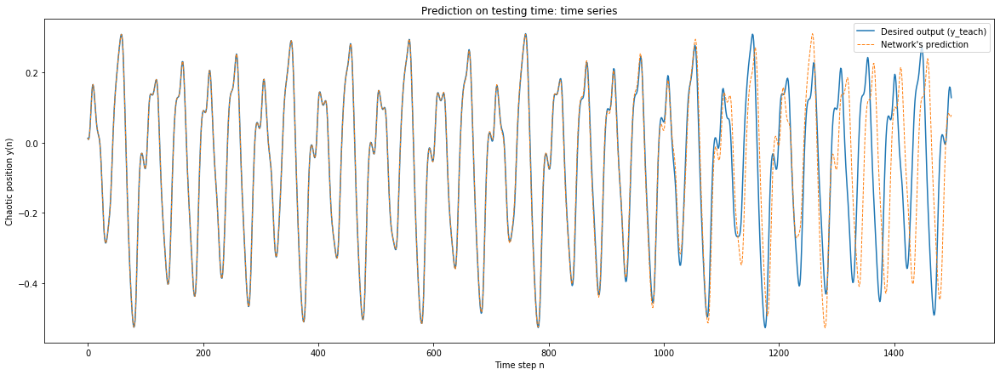

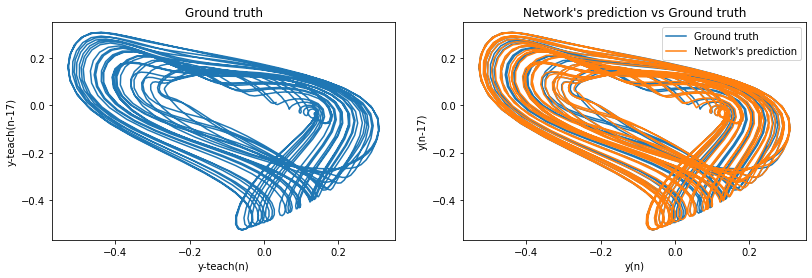

The test MSE is 0.011138187474524244
The 84 NRMSE is 0.0013522875419272559


In [27]:
Network.test_network(t_dismiss=500, t_autonom=1500)

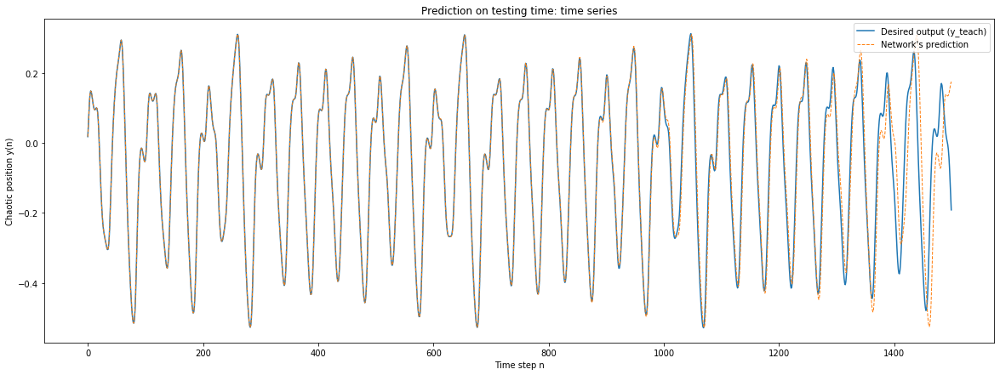

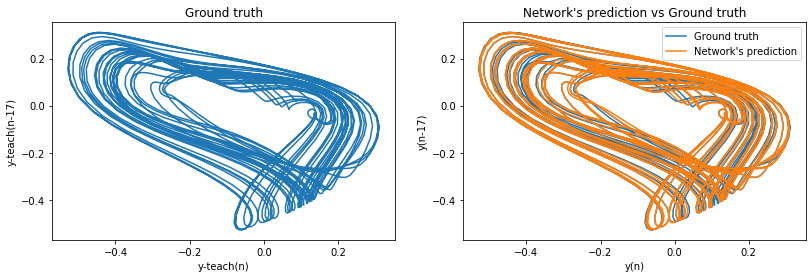

The test MSE is 0.0027444149141321317


In [28]:
Network.test_network(t_dismiss=1000, t_autonom=1500, NRMSE=False)

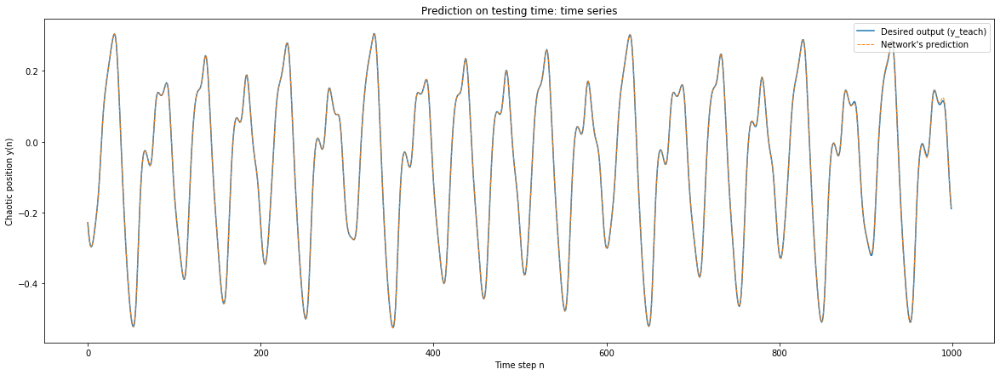

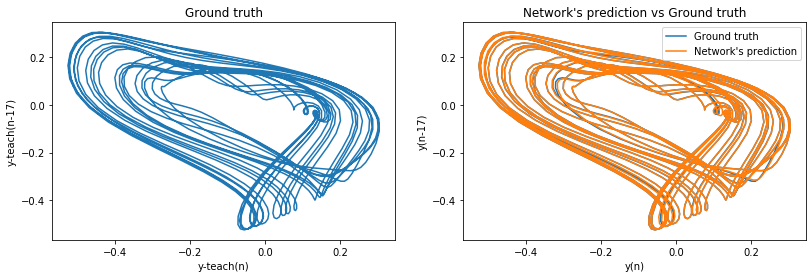

The test MSE is 5.358718750936319e-06


In [29]:
Network.test_network(t_dismiss=2500, t_autonom=1000, NRMSE=False)

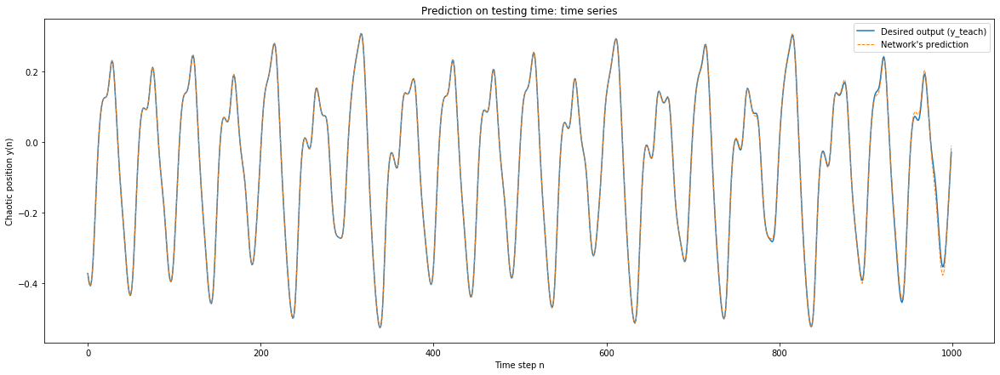

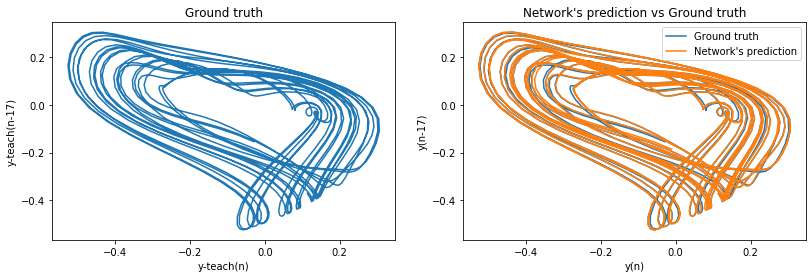

The test MSE is 2.9124585362649192e-05


In [30]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000, NRMSE=False)

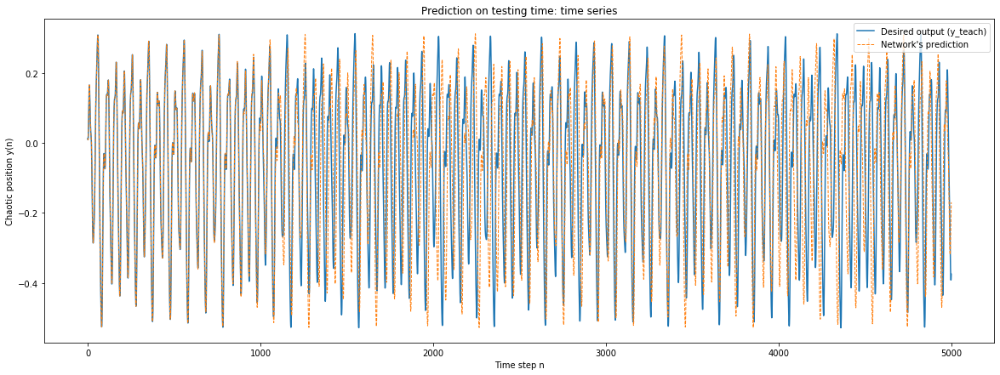

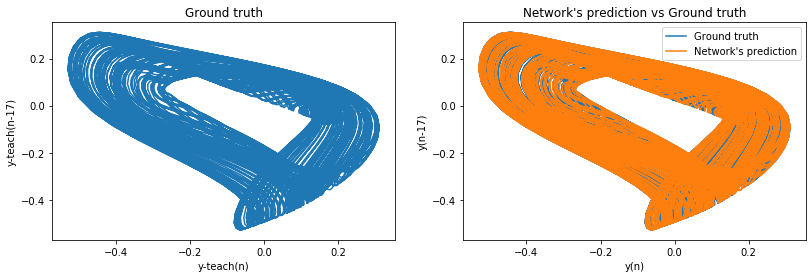

The test MSE is 0.042818327825513244


In [31]:
Network.test_network(t_dismiss=500, t_autonom=5000, NRMSE=False)

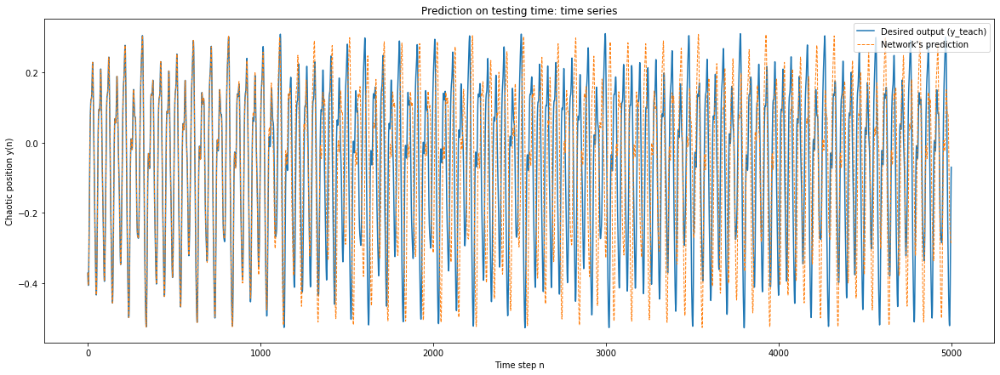

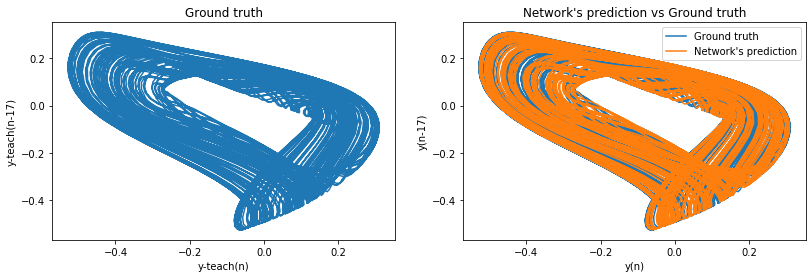

The test MSE is 0.06039937474026361


In [32]:
Network.test_network(t_dismiss=Network.T, t_autonom=5000, NRMSE=False)

### Training and testing the network for different initial conditions.

Recall that, so far, we have considered $y(0)=1.2$. Let us now see what happens if we take as initial condition y(0)=1, 1.5 or 5, for instance.


Initial condition y(0)=1

The training MSE is 1.8635828973961866e-11


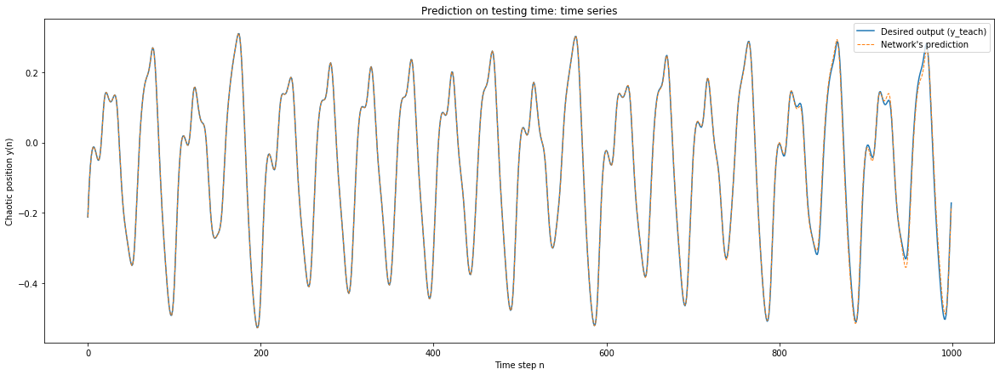

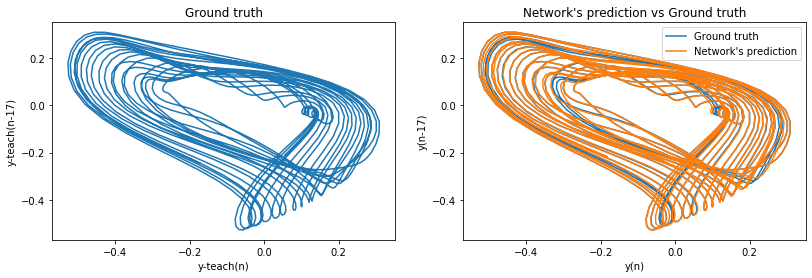

The test MSE is 5.208030821043771e-05
The 84 NRMSE is 0.0014999936147624064

Initial condition y(0)=1.5

The training MSE is 1.8884393884049296e-11


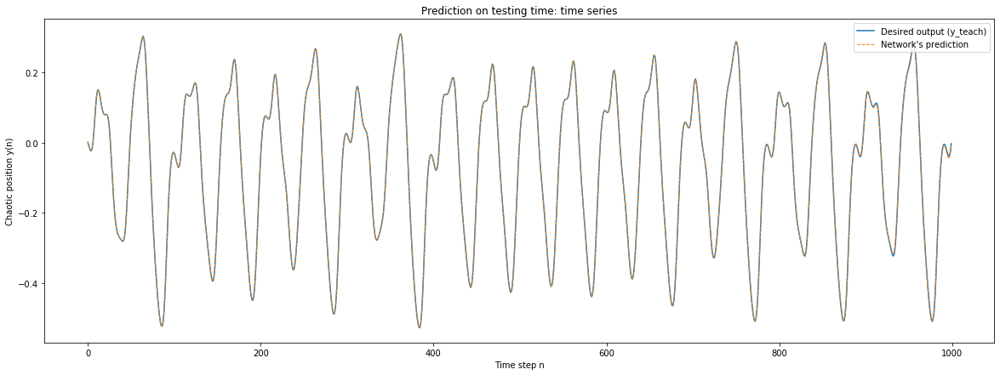

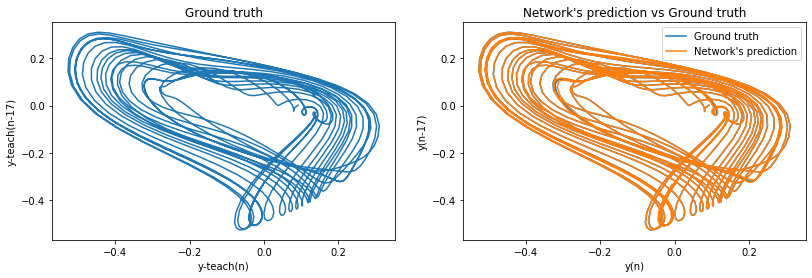

The test MSE is 4.2310045280768176e-06
The 84 NRMSE is 0.0012580553976734344

Initial condition y(0)=5

The training MSE is 1.8789495283992614e-11


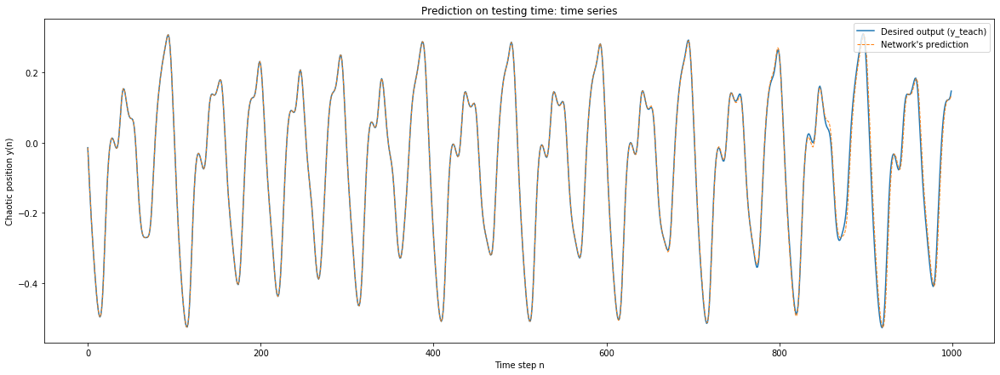

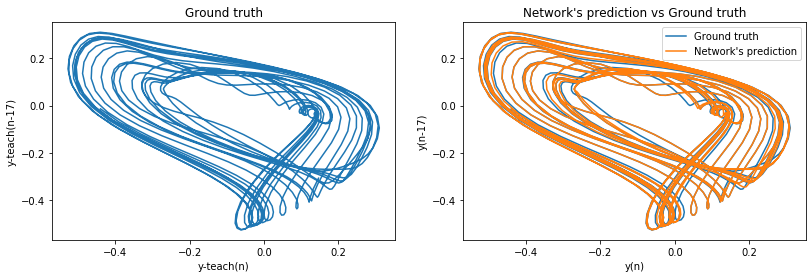

The test MSE is 0.00014488962332637835
The 84 NRMSE is 0.0014612111728039934


In [33]:
Network.train_test_init_cond([1, 1.5, 5], test_time=1000)


Initial condition y(0)=1

The training MSE is 1.8635828973961866e-11


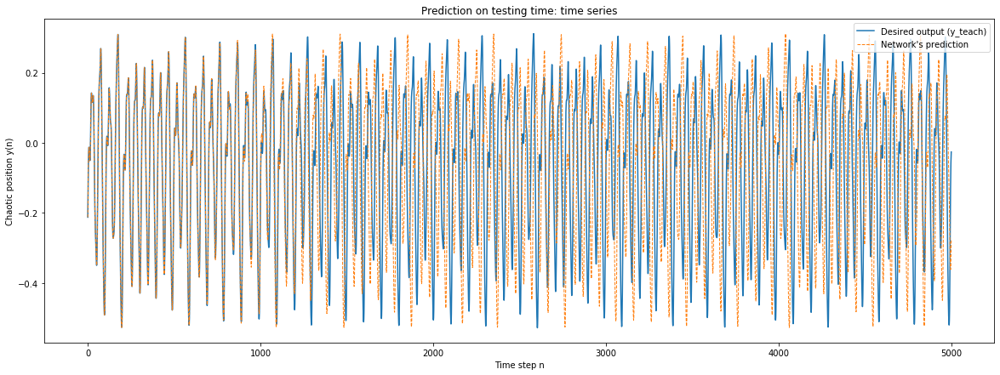

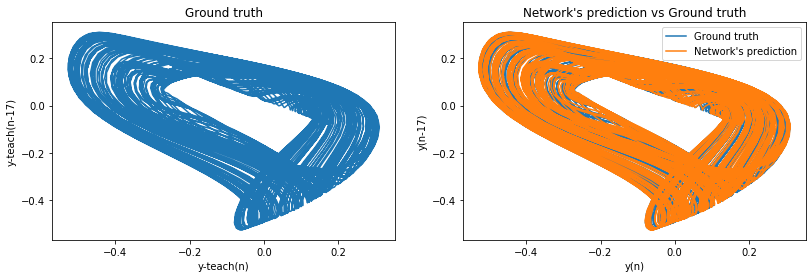

The test MSE is 0.09479855824248472
The 84 NRMSE is 0.0014999936147624064

Initial condition y(0)=1.5

The training MSE is 1.8884393884049296e-11


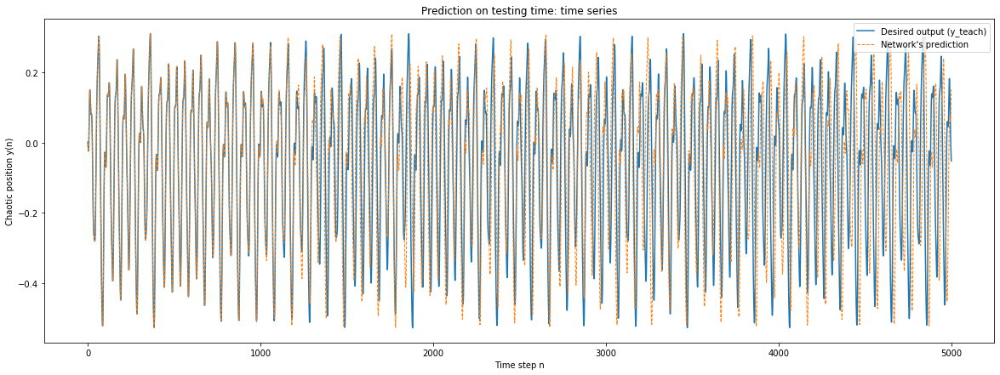

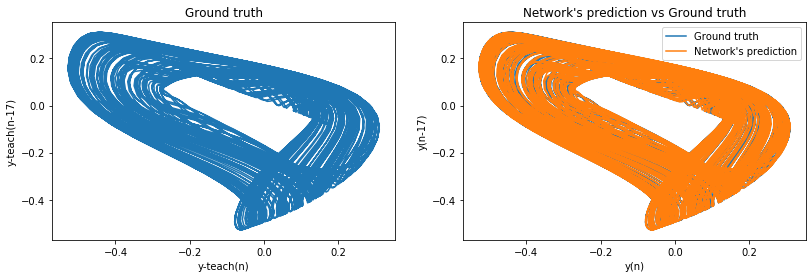

The test MSE is 0.03585341605772457
The 84 NRMSE is 0.0012580553976734344

Initial condition y(0)=5

The training MSE is 1.8789495283992614e-11


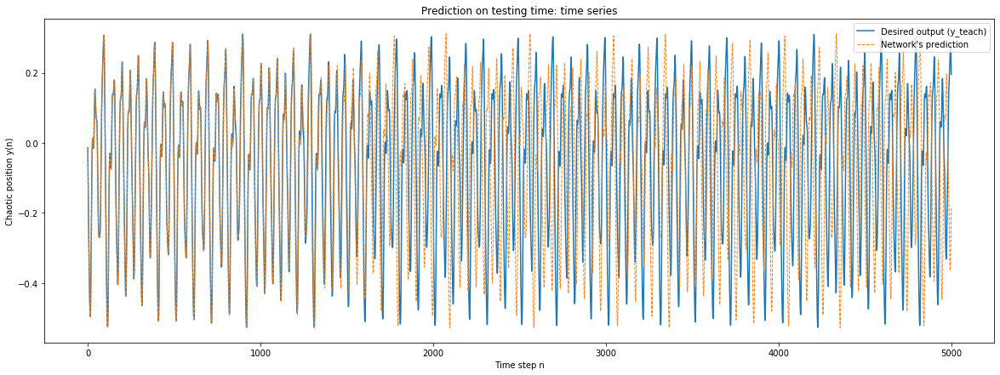

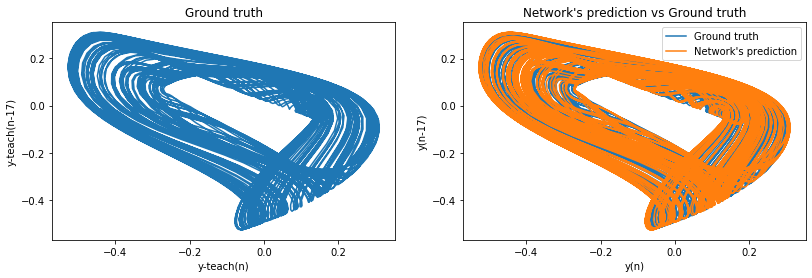

The test MSE is 0.07122798770945199
The 84 NRMSE is 0.0014612111728039934


In [34]:
Network.train_test_init_cond([1, 1.5, 5], test_time=5000)

The results are quite similar to the ones achieved in [Section 3.1](#Delay17_3000). See [Section 3.3](#Delay17_Comparison) to see a wrap up of the results and the conclusions we can extract from the experiments performed so far.

## 3.3 Comparison: T=3000 vs T=21000 <a name="Delay17_Comparison"></a>

Let us begin by wrapping up the results obtained in [Section 3.1](#Delay17_3000) and [Section 3.2](#Delay17_21000). For both cases, we have performed the same experiments in order to be able to compare them. The results obtained are the following:

<img src="Images/table_17.png" alt="table_17" width="500"/>

**Remark on the notation:** recall that the testing procedure begins with some time steps of teacher forcing, which are required in order to let the internal states of the reservoir converge. Afterwards, it can freely run for the desired number of time steps. Therefore, the notation $\text{MSE}_\text{test}(n,m)$ means the testing MSE obtained when the network freely run for $m$ time steps after $n$ steps of teacher forcing.

As already stated, the main goal is to learn the dynamics. That is, we are interested in reproducing the data seen while training as well as predicting the unseen data that would come after the training time steps. Let us begin by focusing on the latter, which concerns the experiments with $T$ teacher forcing steps. Within this group of experiments, we see that when 1000 steps are predicted, the results are more accurate for $T=21000$ than for $T=3000$. However, by looking at the errors and the plots, it appears that the precision achieved for $T=3000$ is good enough in most of the experiments. If we now regard the experiments for which 5000 steps were predicted, we see that the results obtained for $T=21000$ are slightly worse than for $T=3000$ but quite equivalent.

Another good metrics for measuring the precision of the predictions is the $\text{NRMSE}_{84}$. Notice that, in some experiments, such metrics gets better for $T=21000$ whereas, in some others, it gets worse. Despite such slight variations, both metrics are quite similar for both values of $T$.

On the other hand, by looking at the errors and the plots, we may say that replicating values already seen while training do not always provide precise results.

Finally, it is worth noting that, even though the prediction may degenerate, it still follows a dynamics that resembles that of a Mackey-Glass system. In addition, the degenerated prediction may end up recovering precision and getting closer to the orginal one whenever it encounters less chaotic behaviors.

As we have already discussed, the network predicts quite precisely the next 1000 time steps that follow the training although it can just approximate the next 5000. By analyzing the experiments done so far, it seems that the problem does not lie on the quantity of data available (since the results for $T=3000$ and $T=21000$ have appeared to be similar) but on the network's capacity. In other words, a reservoir with 400 nodes is not capable of learning the dynamics at the extent of precisely predicting 5000 time steps. In the next section, we are going to see what happens if such capacity is incremented.

## 3.4 Increasing network's capacity <a name="Delay17_Capacity"></a>

The network we have been dealing with so far is composed of a reservoir with 400 nodes. As we have seen, it has been enough for predicting the next 1000 steps that follows the training but not the next 5000. In this section, we are going to increase the capacity of the network by adding more nodes to the reservoir. By doing so, we expect to increase the prediction capability of the network.

The network we will be dealing with in this section will have a reservoir with 1500 nodes. In addition, the training sequence is going to be of size $T=7000$. 

Since we are changing the number of nodes, the parameters of the network have to be defined again, since their sizes are going to change.

In [75]:
#############
#Parameters of the network
#############
Network.K = 1
Network.N = 1500 #number of nodes
Network.L = 1
Network.W_in = np.random.choice([0,0.14,-0.14], Network.N, p=[0.5, 0.25, 0.25]).reshape((Network.N,Network.K))
Network.W_back = np.random.uniform(low=-0.56, high=0.56, size=Network.N).reshape((Network.N,Network.L))
Network.non_null_matrices = ["W_back", "W_in"]
Network.u = 0.2*np.ones([Network.K,1])

#############
#Reservoir
#############
Network.W = np.random.choice([0,0.4,-0.4], Network.N*Network.N, p=[0.9875, 0.00625, 0.00625]) #adjacency matrix
Network.W = Network.W.reshape((Network.N, Network.N))

#rescale Network.W
alpha = 0.79/max(abs(scipy.linalg.eigvals(Network.W)))
Network.W = alpha*Network.W
print("The maximum eigenvalue (in module) is {}".format(max(abs(scipy.linalg.eigvals(Network.W)))))
_,s,_ = scipy.linalg.svd(Network.W)

The maximum eigenvalue (in module) is 0.7900000000000071


In [76]:
Network.T = 7000
Network.n_min = 1000
Network.sigma = 17
Network.InitialCondition_ODE = [1.2]
Network.delta = 1
Network.C = 0.44
Network.a = 0.9

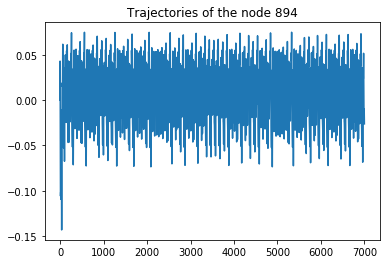

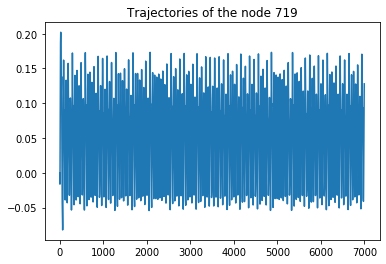

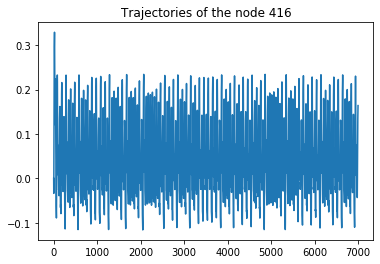

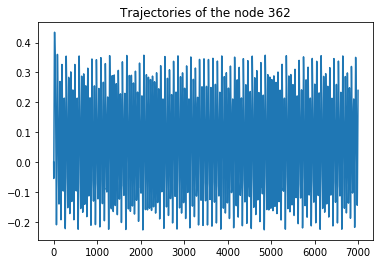

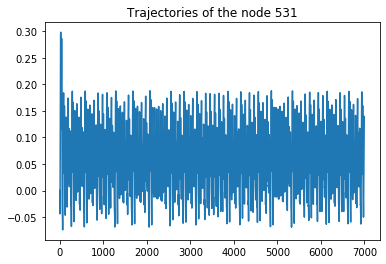

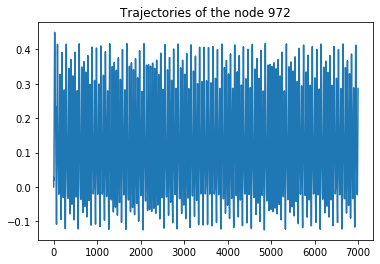

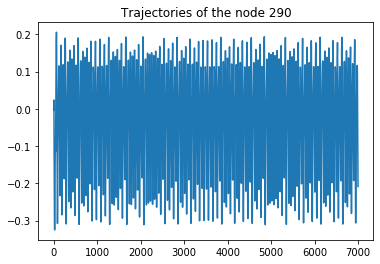

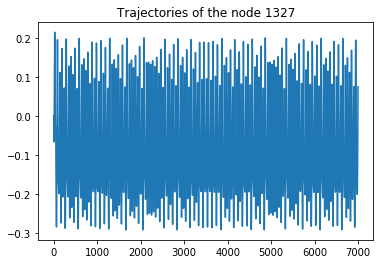

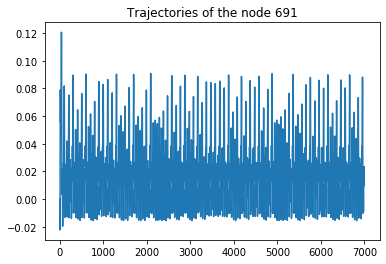

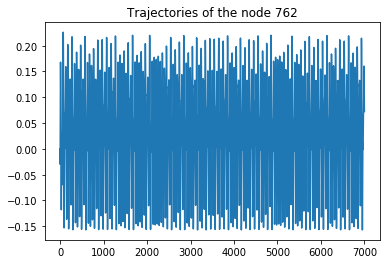

The training MSE is 6.0219172359141e-16


In [77]:
#TRAINING
#After the plots, the training MSE is printed
Network.train_network(plot=True)

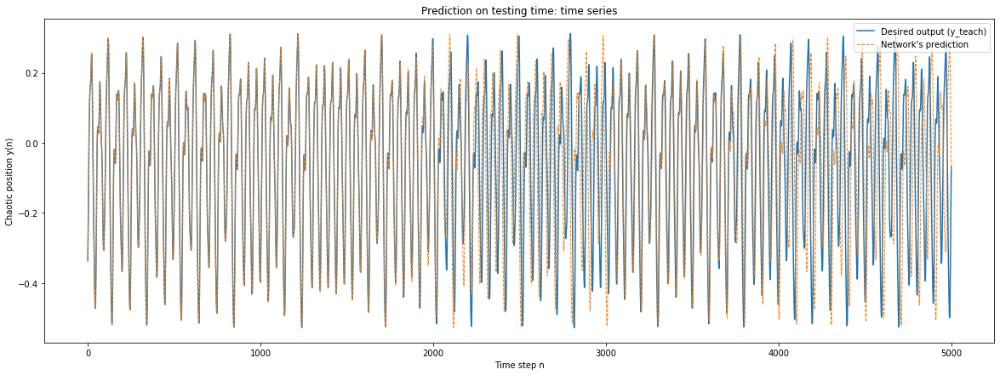

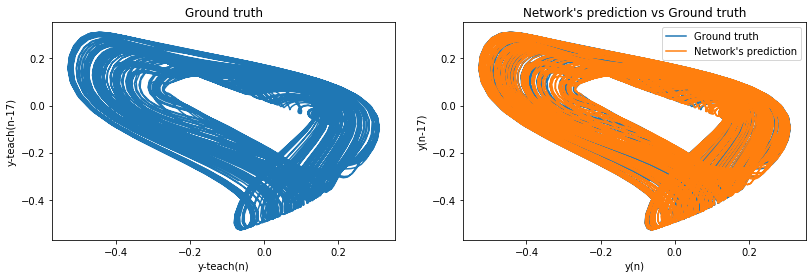

The test MSE is 0.03261561383794386
The 84 NRMSE is 3.435700862947944e-05


In [78]:
Network.test_network(t_dismiss=Network.T, t_autonom=5000)

By increasing the network's capacity, we have achieved a greater prediction capability. On the one hand, the value of the $\text{NRMSE}_\text{84}$ has been divided by 100. Therefore, this network is 100 times more precise in the long term than any of the previous ones. On the other hand, can visually infer that, at this time, we can precisely predict almost 2000 time steps against the 1000 we got in previous sections.

Therefore, we may finally say that, in case of being interested in precisely predicting a certain number of $\tilde{T}$ time steps, for $T<t<\tilde{T}$, we will need to increase the capacity of the network. However, keep in mind that, as such capacity increases, so does the computational cost.

## 4. Training the network taking a delay of $\sigma = 30$ <a name="Delay30"></a>

Let us now train our network so as to make it capable of predicting a Mackey-Glass system with $\sigma = 30$. Notice that the chaos present in such system is wilder for $\sigma = 30$ than for the previous value $\sigma = 17$. In fact, we will now have to introduce some noise during training to increase the robustness of the reservoir. Therefore, the updating is going to be performed as follows:

$$
x(n+1) = (1-\delta Ca)x(n)+\delta C\left[ \tanh\left( W^\text{in}u(n+1)+Wx(n)+W^\text{back}y^\text{teach}(n) + \nu(n)\right) \right],
$$

with $\delta=1$, $C=0.44$ and $a=0.9$. The noise is going to be uniformly sampled from the interval $[-0.00001,0.00001]^{400}$. Despite this fact, we are also analizing the behavior for other types of noise. For more details related with the task see [Section 2](#).

First of all, the network is going to be trained with a sequence of length $T=3000$ ([Section 4.1](#Delay30_3000)) and, afterwards, with a sequence of lenght $T=21000$ ([Section 4.2](#Delay30_21000)). The results will be compared in [Section 4.3](#Delay30_Comparison). Finally, the capacity of the network is going to be increased so as to see whether its prediction capability increases as well. Notice that this section is structured in the same way as [Section 3](#Delay17).

## 4.1 Training with a sequence of length  T = 3000 <a name="Delay30_3000"></a>

The training sequence will be of size T=3000 and will be constructed by taking $\sigma=30$.

In [5]:
#############
#Parameters of the network
#############
Network.K = 1
Network.N = 400
Network.L = 1
Network.W_in = np.random.choice([0,0.14,-0.14], Network.N, p=[0.5, 0.25, 0.25]).reshape((Network.N,Network.K))
Network.W_back = np.random.uniform(low=-0.56, high=0.56, size=Network.N).reshape((Network.N,Network.L))
Network.non_null_matrices = ["W_back", "W_in"]
Network.u = 0.2*np.ones([Network.K,1])

#############
#Reservoir
#############
Network.W = np.random.choice([0,0.4,-0.4], Network.N*Network.N, p=[0.9875, 0.00625, 0.00625]) #adjacency matrix
Network.W = Network.W.reshape((Network.N, Network.N))

#rescale Network.W
alpha = 0.79/max(abs(scipy.linalg.eigvals(Network.W)))
Network.W = alpha*Network.W
print("The maximum eigenvalue (in module) is {}".format(max(abs(scipy.linalg.eigvals(Network.W)))))
_,s,_ = scipy.linalg.svd(Network.W)

The maximum eigenvalue (in module) is 0.7899999999999932


In [6]:
Network.T = 3000
Network.n_min = 1000
Network.sigma = 30
Network.InitialCondition_ODE = [1.2]
Network.delta = 1
Network.C = 0.44
Network.a = 0.9

In [7]:
#TRAINING
Network.train_network(plot=False, noise=True)

The training MSE is 3.036901651429965e-07


We obtained a training MSE of around 3.04e-7 (although this value may slightly vary depending on the execution). Notice that it is higher than when we took $\sigma=17$.

Let us now test the network. Recall that the metrics $\text{NRMSE}_\text{84}$ only depends on the trained network. Therefore, it will only be computed once (in the first experiment).

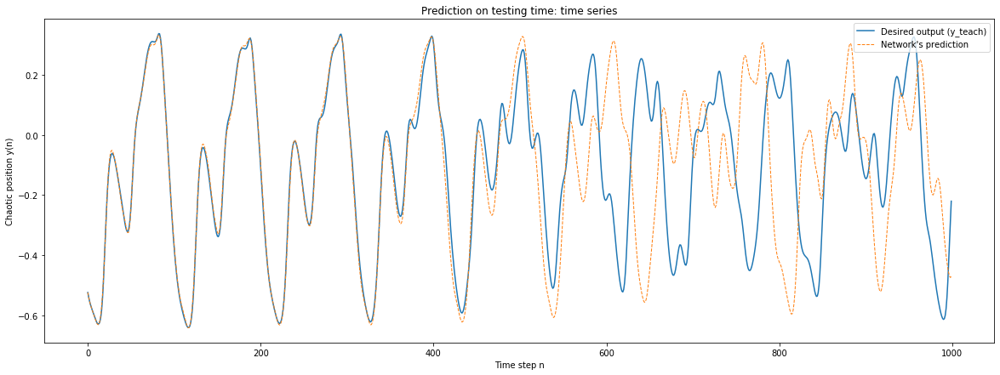

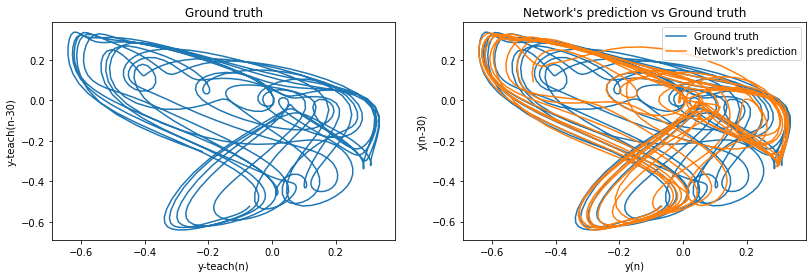

The test MSE is 0.05847444619069438
The 84 NRMSE is 0.9045626003104291


In [9]:
Network.test_network(t_dismiss=500, t_autonom=1000)

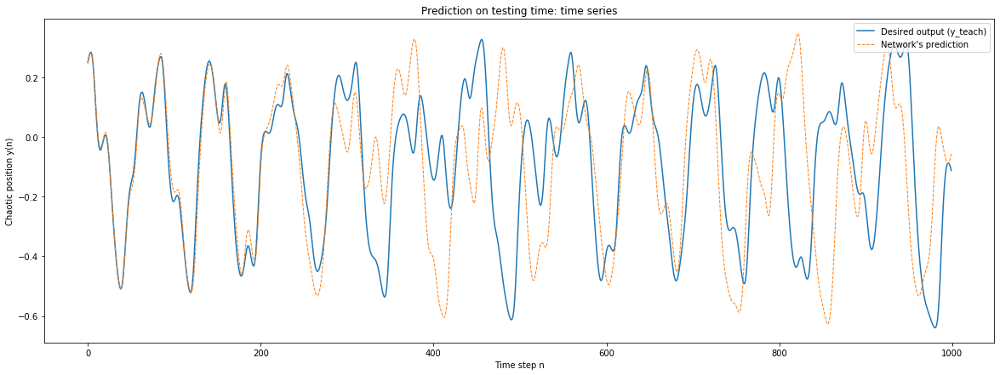

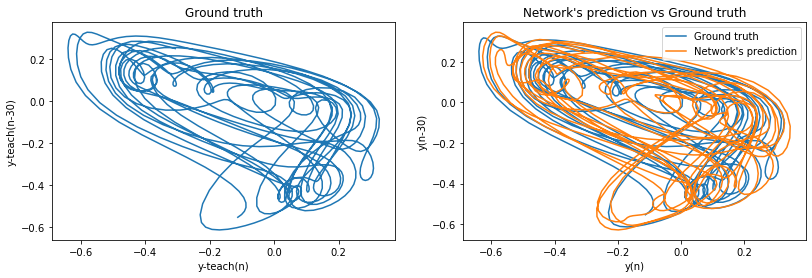

The test MSE is 0.06284020321431744


In [10]:
Network.test_network(t_dismiss=1000, t_autonom=1000, NRMSE=False)

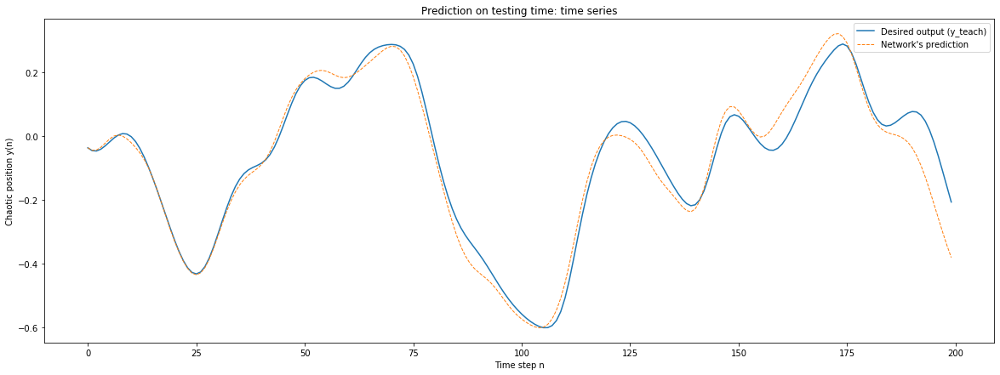

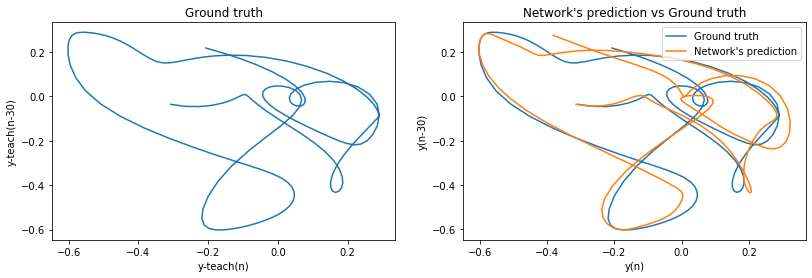

The test MSE is 0.0027149092661578234


In [14]:
Network.test_network(t_dismiss=Network.T, t_autonom=200, NRMSE=False)

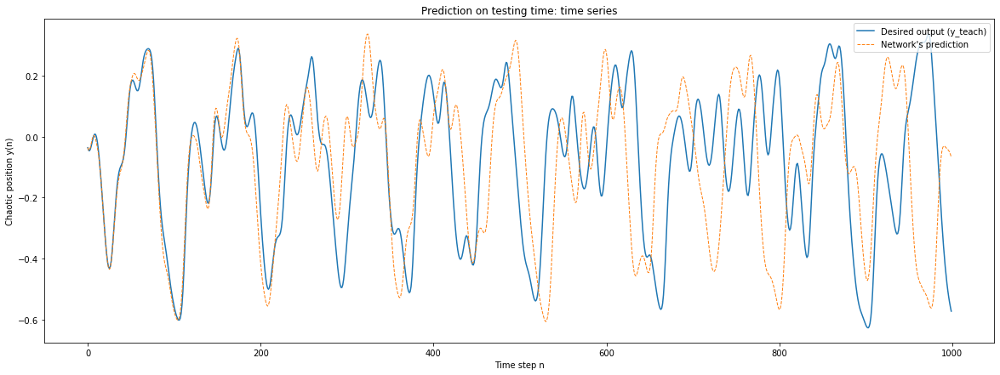

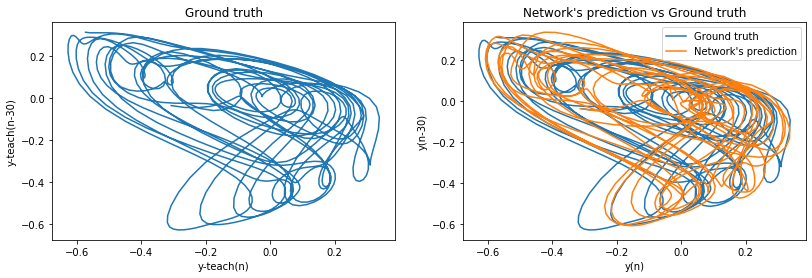

The test MSE is 0.07000311668920346


In [15]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000, NRMSE=False)

The three images above illustrate what we already knew: when $\sigma=30$, the chaos of a Mackey-Glass system is wilder than when $\sigma=17$. In addition, we got a value of $\text{NRMSE}_{84}=0.90456$, which is higher.

On the other hand, when comparing the images, it can be inferred that the level of chaos at different points of time is not necessarily the same. In this case of study, we see that the level of chaos increases after 400 time steps in the first experiment and after 200 time steps in the second experment. In fact, this is what makes prediction of chaotic systems so hard: there may be periods where little deviations remain quite stable (easier to predict) but there are other periods where little deviations quickly diverge (harder to predict).

Finally, let us look at the third and fourth experiments, which consists on predicting the time steps that follow the training, which is unseen data. There, we can see that after 200 time steps, the prediction does not coincide, by far, with the true trajectory (plotted in blue). However, notice that, even though it does not coincide, the prediction follows a trajectory that actually resembles that of a Mackey-Glass system with $\sigma=30$.

### Training and testing the network for different initial conditions <a name="Delay30_3000_CI"></a>

In the previous experiments of this section, we have considered $y(0)=1.2$. Let us now see the behavior of the prediction when the initial condition is 1, 1.5 and 5. In all these experiments, we are going to predict the next 200 and 1000 time steps of the training sequence. Therefore, we are predicting data that has not been previously seen.


Initial condition y(0)=1

The training MSE is 2.693579956712325e-07


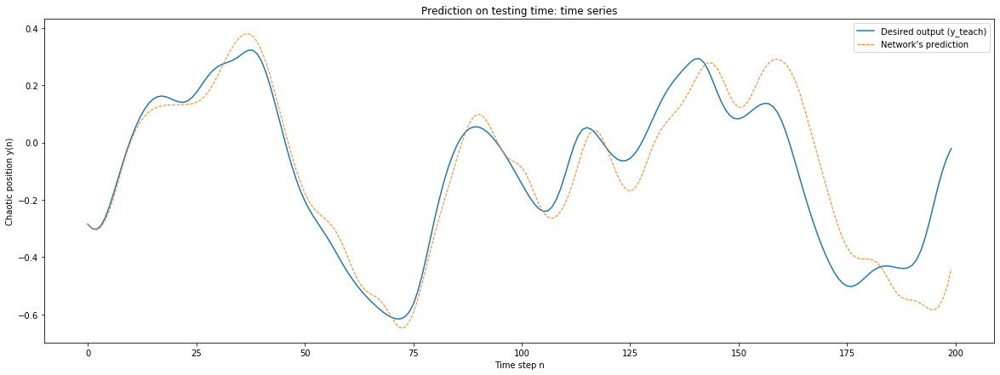

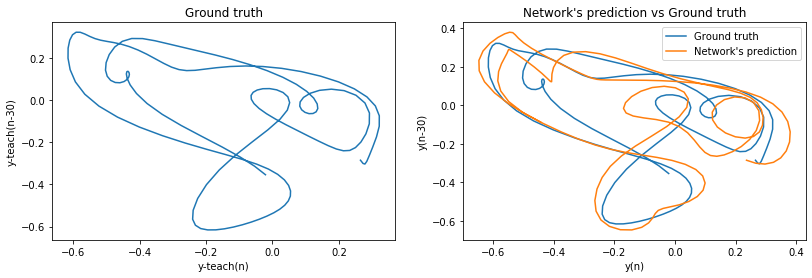

The test MSE is 0.013758157770827317
The 84 NRMSE is 0.7928157244813393

Initial condition y(0)=1.5

The training MSE is 3.4511992179072737e-07


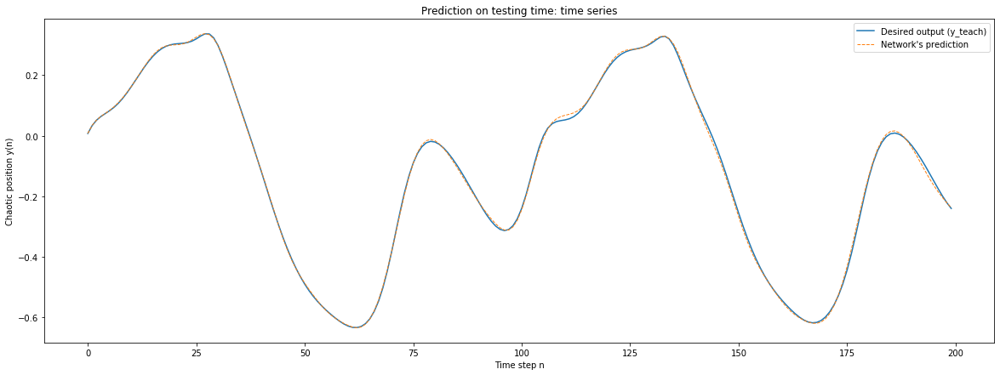

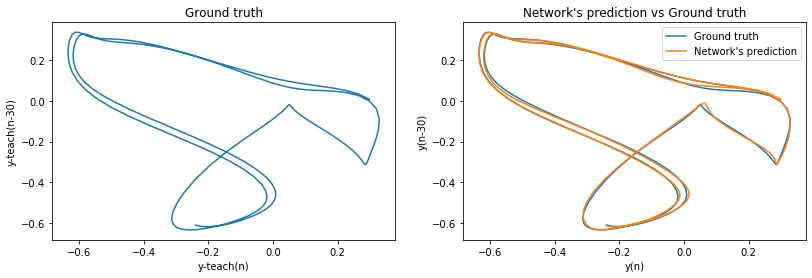

The test MSE is 3.9622760721327607e-05
The 84 NRMSE is 1.1207227350635653

Initial condition y(0)=5

The training MSE is 3.3413929730463867e-07


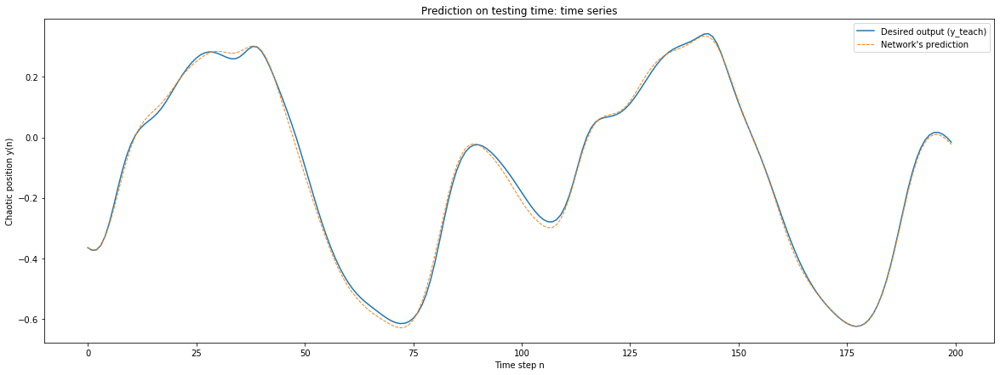

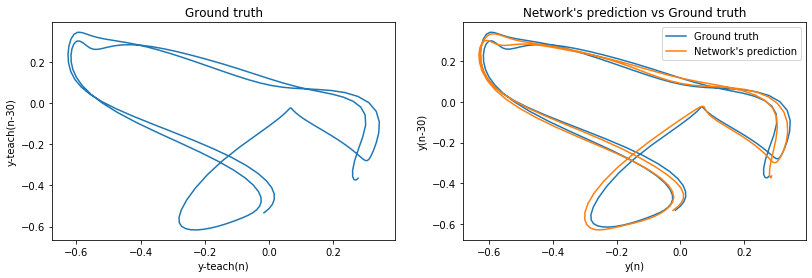

The test MSE is 0.00016520549870122084
The 84 NRMSE is 0.7145513864472494


In [16]:
Network.train_test_init_cond([1, 1.5, 5], test_time=200, noise=True)


Initial condition y(0)=1

The training MSE is 2.744245006821699e-07


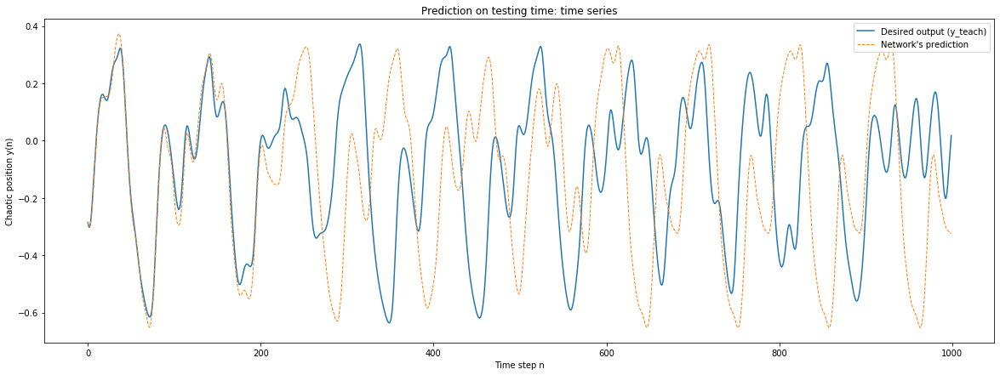

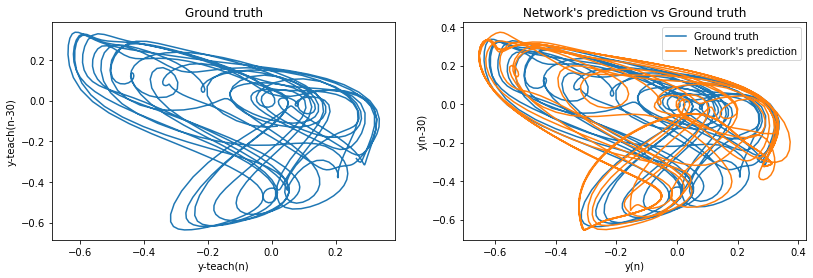

The test MSE is 0.122541677908517
The 84 NRMSE is 0.835479164587208

Initial condition y(0)=1.5

The training MSE is 3.5536247745349896e-07


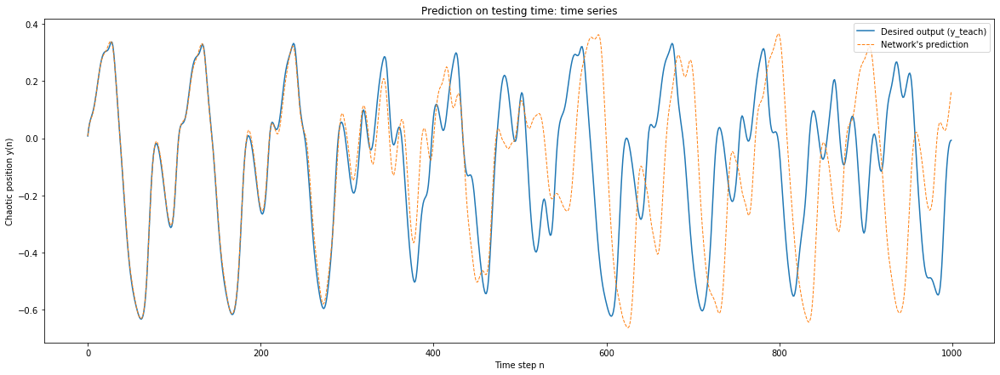

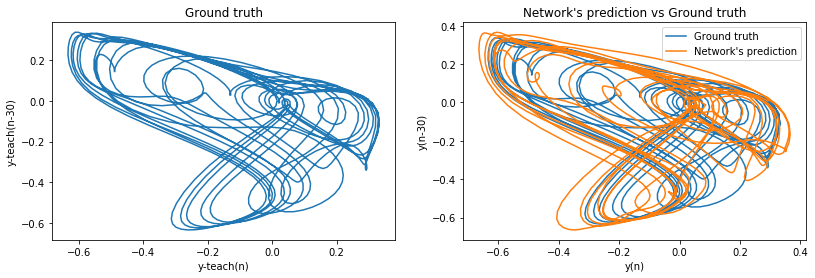

The test MSE is 0.07438778100215039
The 84 NRMSE is 0.5580400241216773

Initial condition y(0)=5

The training MSE is 3.144151817339406e-07


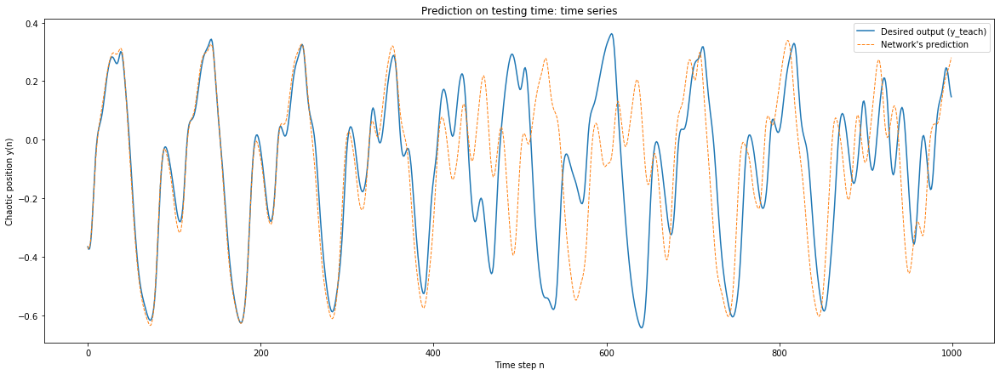

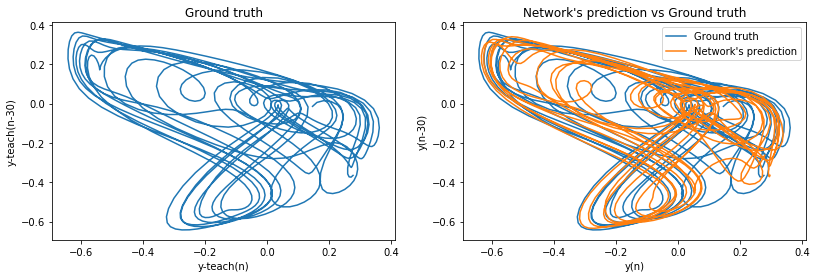

The test MSE is 0.050278779260228446
The 84 NRMSE is 0.7285197800723794


In [17]:
Network.train_test_init_cond([1, 1.5, 5], test_time=1000, noise=True)

By means of this procedure, it appears that the network can only reliably predict up to 200 or 250 time steps, depending on the particular case. However, notice that the dynamics of the predictions always resembles that of a Mackey-Glass system, even when it degenerates.

### Training the network with different levels of noise

Let us now train again the network with an initial condition of $y(0)=1.2$ but let us now modify the levels of noise so as to see the role it plays. We are going to compare the results with the one obtained when applying the default noise, which is uniformly taken from [-0.00001,0.00001]. In all the experiments, we are going to predict the next 1000 of the sequence used for training. That is, we are predicting data that has not been seen before.

In [18]:
Network.InitialCondition_ODE = [1.2]

**NO NOISE**

In [22]:
#training
Network.train_network(plot=False, noise=False)

The training MSE is 2.971979395989483e-08


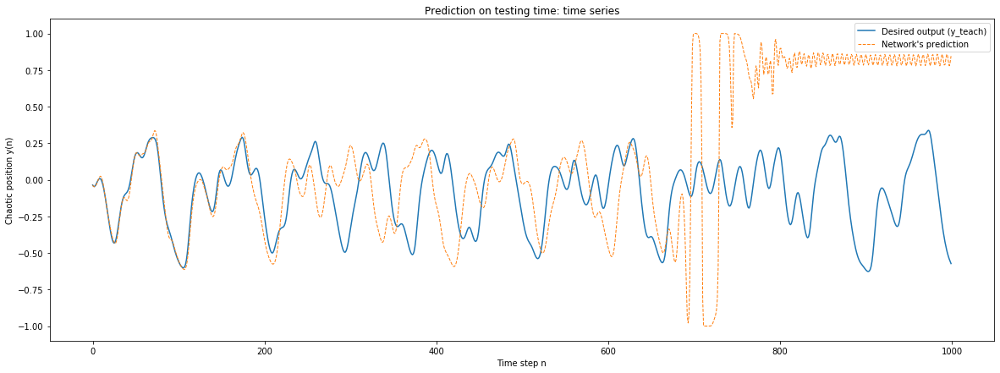

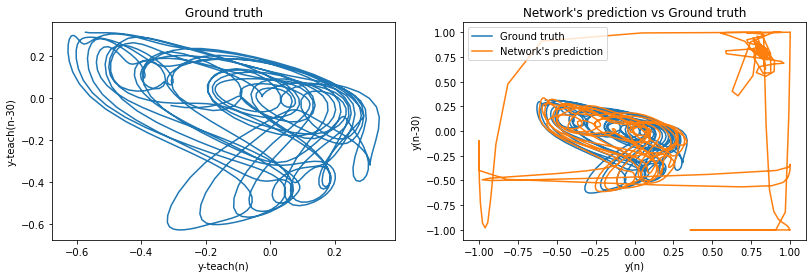

The test MSE is 0.30860913065643525
The 84 NRMSE is 0.6840508575683355


In [24]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000)

We can see that, if we do not add noise while training, the dynamics learnt is not as stable as it was when some noise was introduced. This fact is illustrated in the plots, where we can see that the way of degenerating is different than before. In previous cases, even though the predictions degenerated, they still followed a trajectory that resembled that of a Mackey-Glass system. However, in this experiment, we see that the prediction displays a very different pattern. In particular, notice that around 700 time steps, the trajecotory appears to take values 1 and -1. This means that the predictions take values with large module but, once the tanh has been applied, they collapse to 1 and -1. After such spikes, the results are far away from the desired dynamics.

**NOISE UNIFORMLY TAKEN FROM [-0.0001,0001]**

In [25]:
#training
Network.train_network(plot=False, noise=True, boundary_noise=0.0001)

The training MSE is 1.3580184401561246e-06


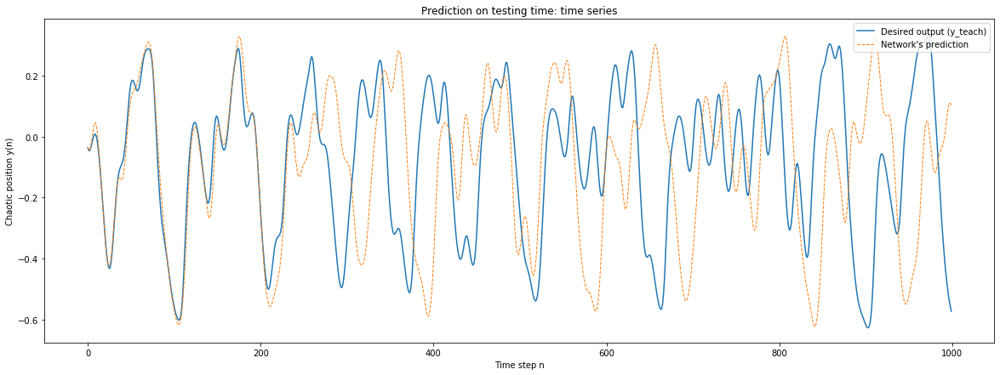

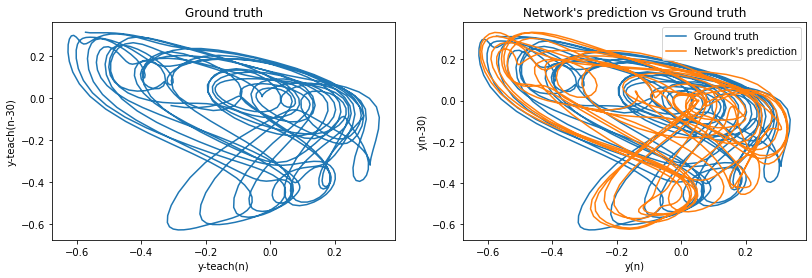

The test MSE is 0.09579660075538925
The 84 NRMSE is 1.464803005292821


In [26]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000)

By looking at the plots, the results appear to be quite similar to the ones obtained with the default noise. However, the $\text{NRMSE}_\text{84}$, which measures the accuracy of the predictions in the long term, is higher. 

**NOISE UNIFORMLY TAKEN FROM [-0.01,0.01]**

In [27]:
#training
Network.train_network(plot=False, noise=True, boundary_noise=0.01)

The training MSE is 5.7137754710423725e-05


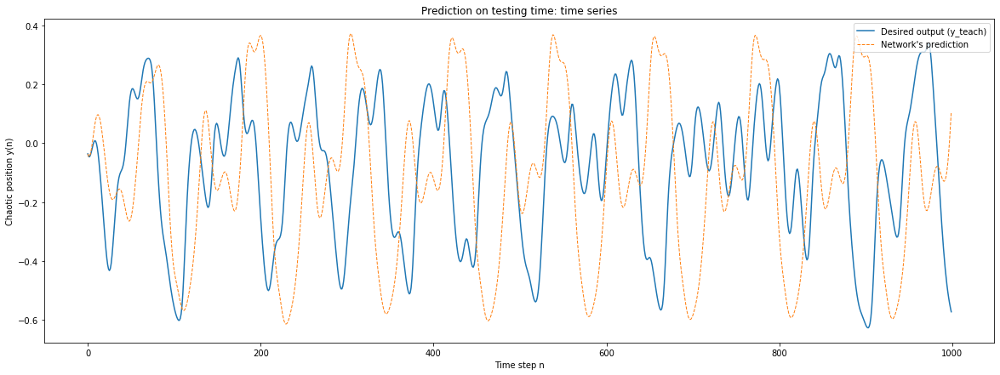

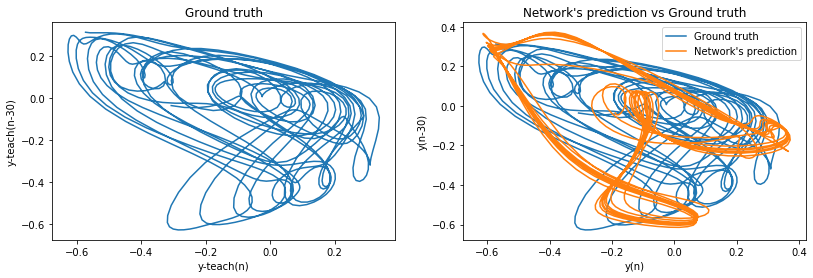

The test MSE is 0.14407907786798066
The 84 NRMSE is 6.969502552263874


In [28]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000)

When the size of the interval is too large, as in this case, the noise does not improve the prediction.

So far, we have selected the noise to be uniformly distributed on a symmetric interval of the form [-a,a]. After performing the experiments, we can see the importance of choosing the appropriate noise. For instance, we see that, if the value of $a$ is too big, then the prediction will end up degenerating, although it will still follow a trajectory resembling that of a Mackey-Glass system. On the other hand, if we do not introduce noise or the value of $a$ is too small, the predictions will degenerate. In this case, the prediction will be far from a Mackey-Glass one.

**Let us finally mention that the results are quite dependant on the execution.**

## 4.2 Training with a sequence of length  T = 21000 <a name="Delay30_21000"></a>

Let us now regard a training sequence of size $T=21000$. Recall that we are in a wildly chaotic setting, since $\sigma=30$. The procedure we are going to carry out is the same as the one developed in [Section 4.1](#Delay30_3000). That is, the parameters of the network as well as the training and testing strategies will be the same. 

We are going to consider the default initial condition, which is $y(0)=1.2$.

In [29]:
Network.T = 21000
Network.n_min = 1000
Network.InitialCondition_ODE = [1.2]

In [30]:
#TRAINING
Network.train_network(plot=False, noise=True)

The training MSE is 4.478115232348047e-07


The training MSE is quite similar to the one obtained for $T=3000$ ([Section 4.1](#Delay30_3000)).

Let us now perform the testing.

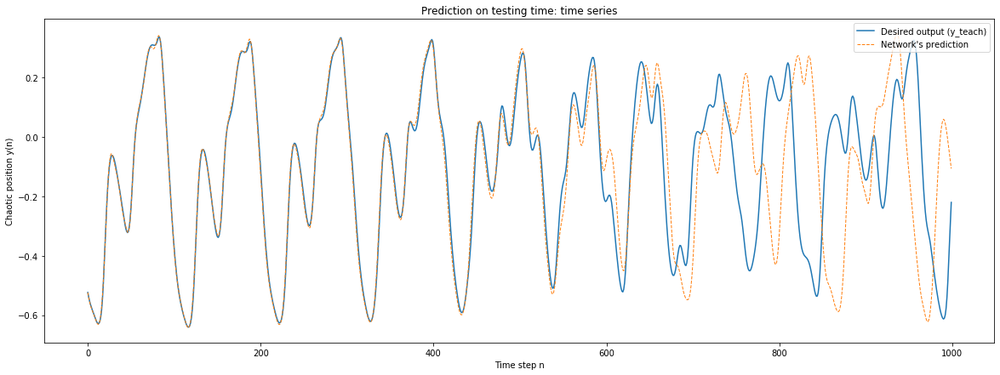

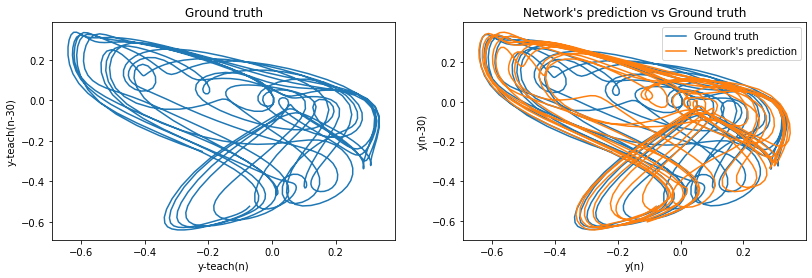

The test MSE is 0.044706240714170634
The 84 NRMSE is 0.3784007271204166


In [31]:
Network.test_network(t_dismiss=500, t_autonom=1000)

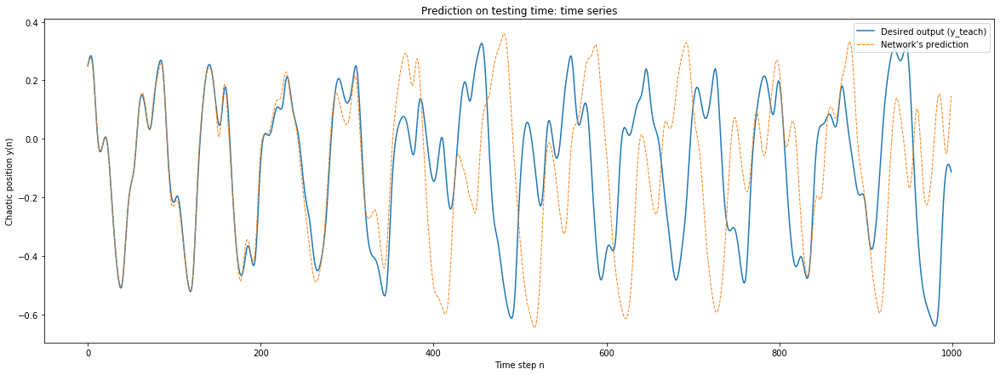

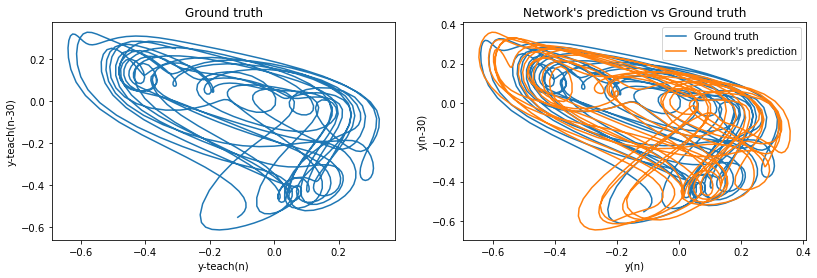

The test MSE is 0.08750782018940285


In [32]:
Network.test_network(t_dismiss=1000, t_autonom=1000, NRMSE=False)

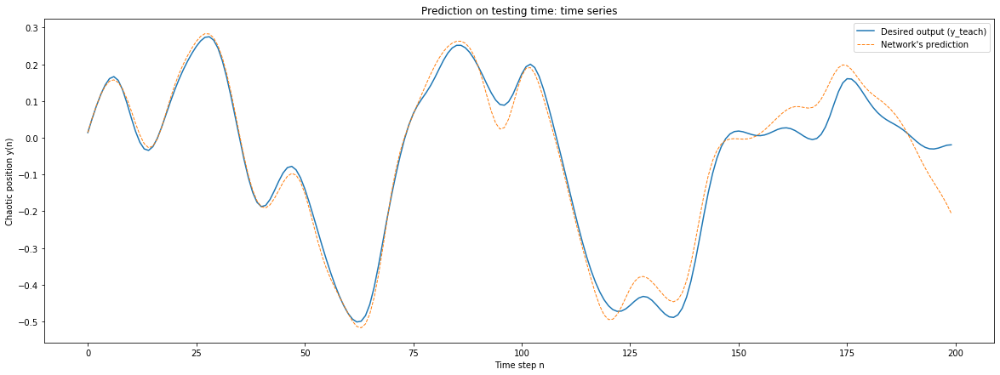

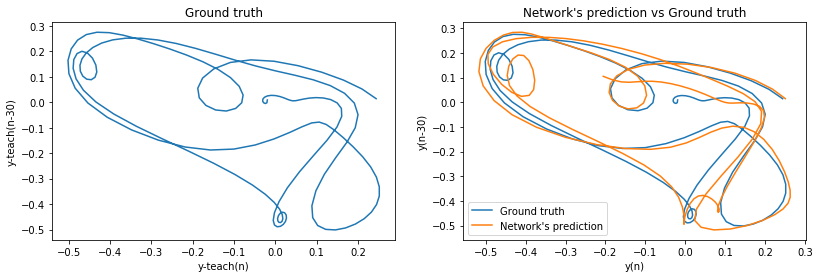

The test MSE is 0.0015694906812230031


In [33]:
Network.test_network(t_dismiss=Network.T, t_autonom=200, NRMSE=False)

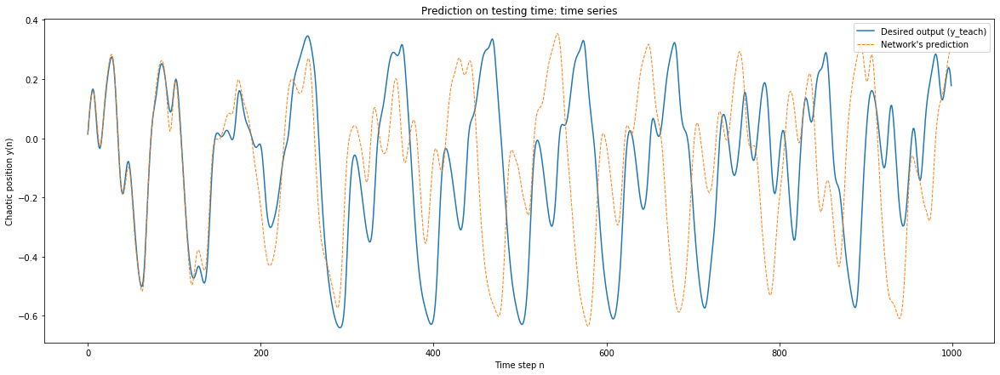

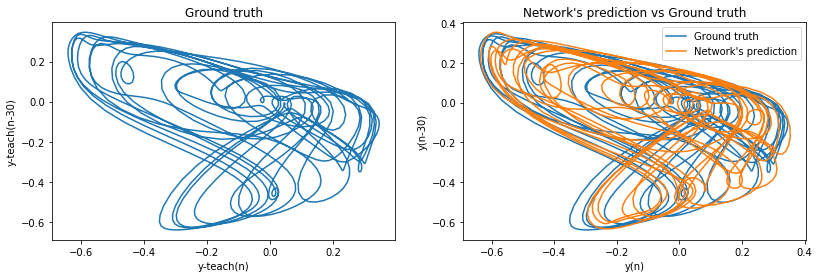

The test MSE is 0.10662108340252378


In [34]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000, NRMSE=False)

Notice that the $\text{NRMSE}_{84}=0.37840$, which is much lower than when we took a training sequence of size 3000. In addition, we can visually infer that this network has increased its prediction capability, since the predictions degenerate later. In addition, it appears that the level of chaos increases as time goes by. In addition, it can also be observed that, in all the cases, the prediction degenerates at some point but still has a shape that resembles a trajectory from the Mackey-Glass system.

See [Section 4.3](#Delay30_Comparison) for the details regarding comparison between both cases.

### Training and testing the network for different initial conditions 

In the previous experiments of this section, we have considered $y(0)=1.2$. Let us now see the behavior of the prediction when such initial condition is changed to $y(0)=1$, $y(0)=1.5$ or $y(0)=5$. In all these experiments, we are going to predict the next 200 and 1000 time steps of the training sequence. Therefore, we are predicting data that has not been previously seen.


Initial condition y(0)=1

The training MSE is 4.779299161171527e-07


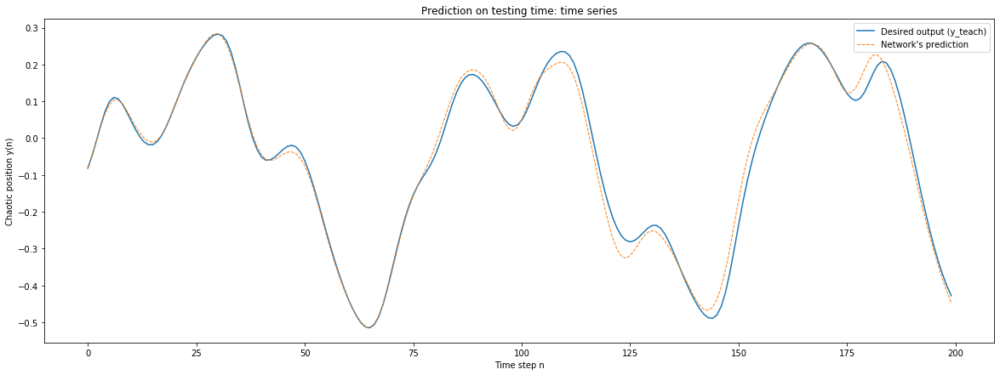

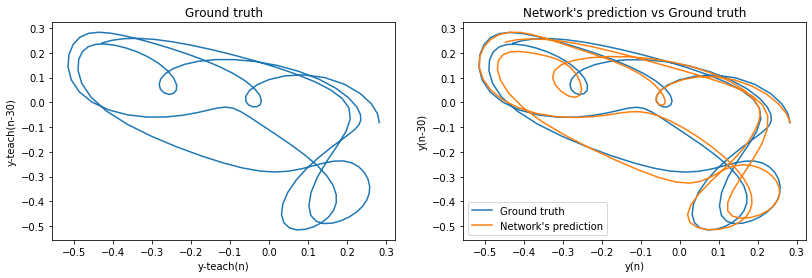

The test MSE is 0.0005683614573394499
The 84 NRMSE is 0.386801630458589

Initial condition y(0)=1.5

The training MSE is 4.7602397408544547e-07


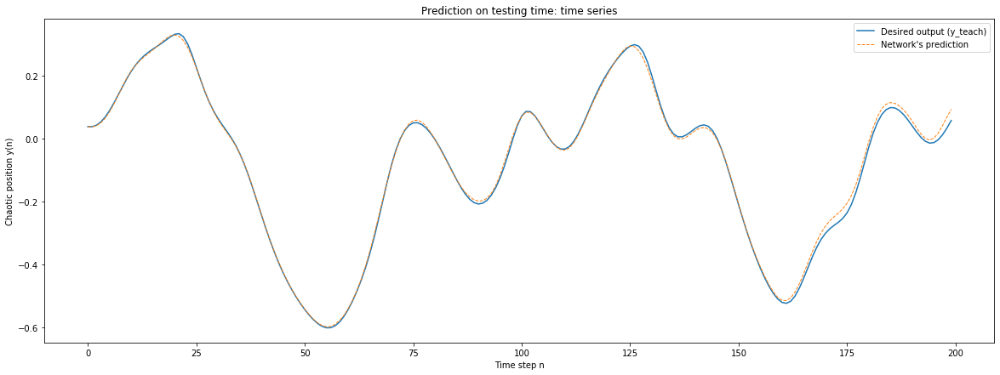

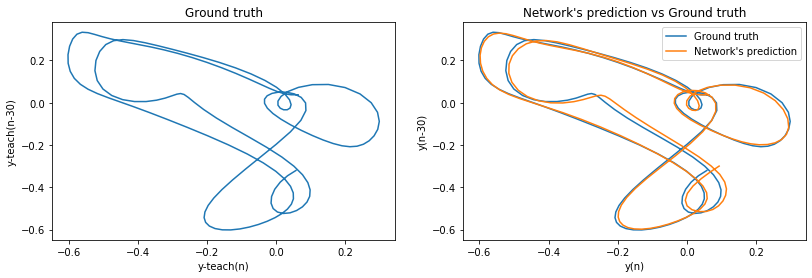

The test MSE is 0.00010676163545828899
The 84 NRMSE is 0.3656331075993689

Initial condition y(0)=5

The training MSE is 4.703499525198358e-07


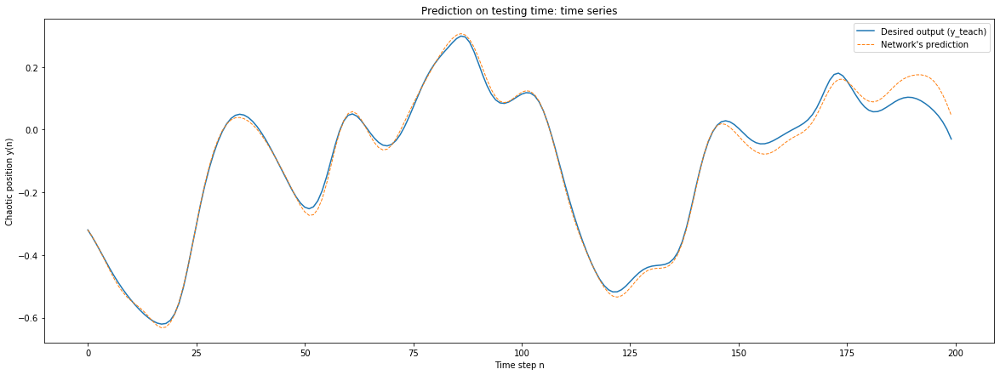

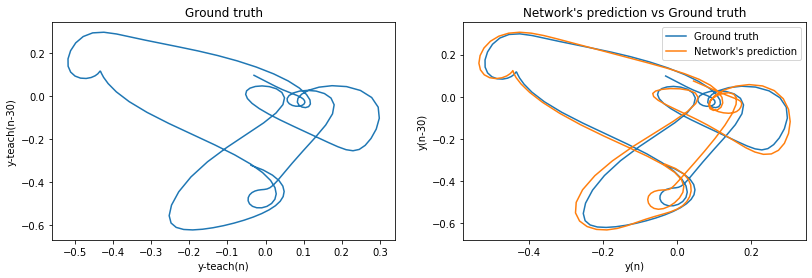

The test MSE is 0.0006407651790365453
The 84 NRMSE is 0.4058474173030002


In [35]:
Network.train_test_init_cond([1, 1.5, 5], test_time=200, NRMSE=True, noise=True)


Initial condition y(0)=1

The training MSE is 4.7644957075540874e-07


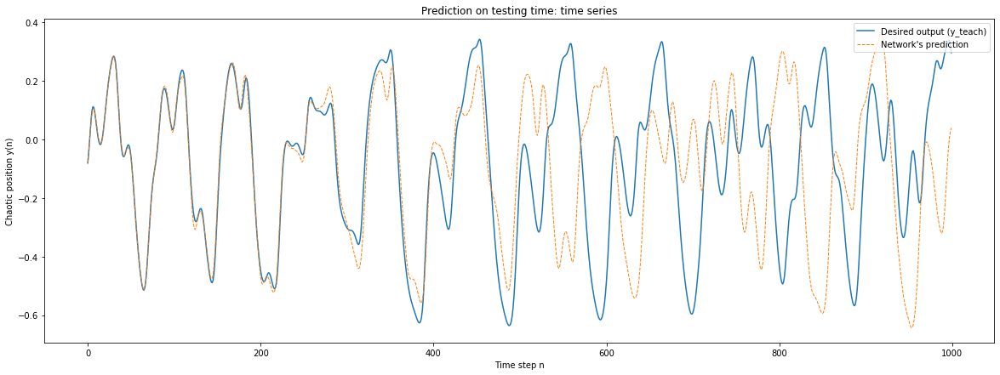

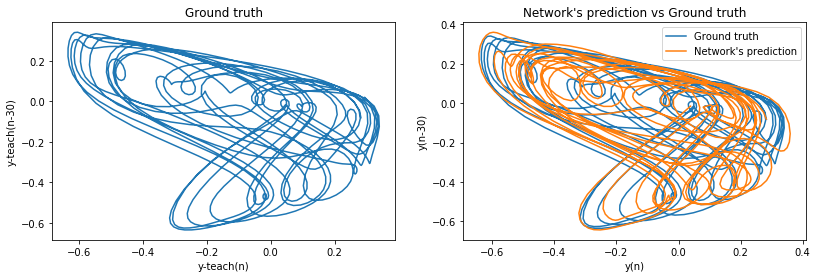

The test MSE is 0.08264992933866323
The 84 NRMSE is 0.3720816896156848

Initial condition y(0)=1.5

The training MSE is 4.710674207661004e-07


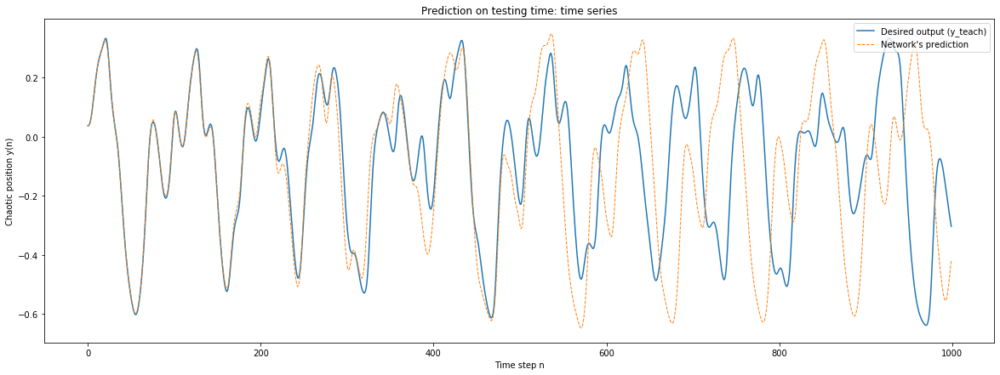

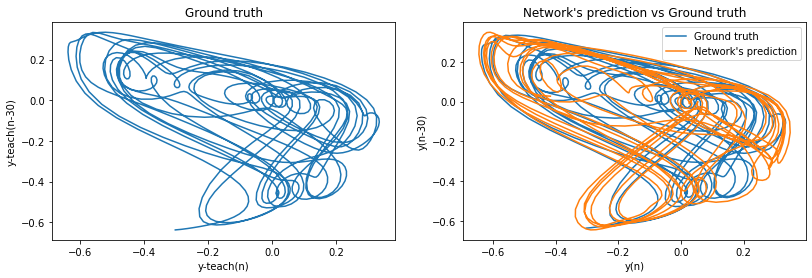

The test MSE is 0.06813475014074315
The 84 NRMSE is 0.3982890358268448

Initial condition y(0)=5

The training MSE is 4.6524349940088957e-07


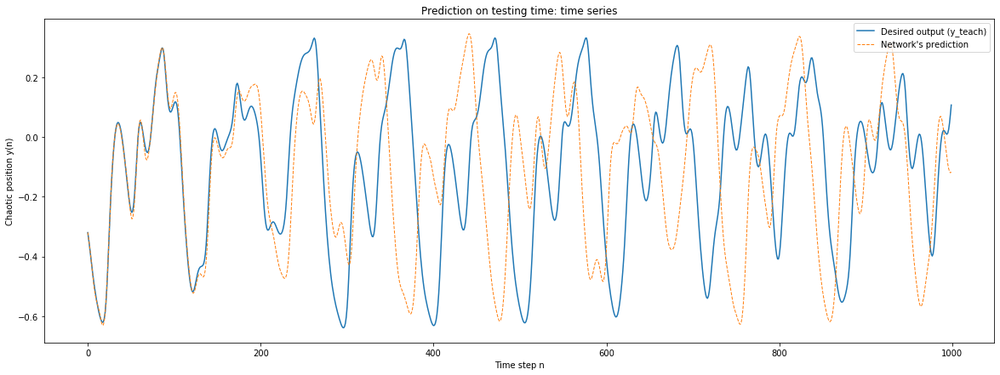

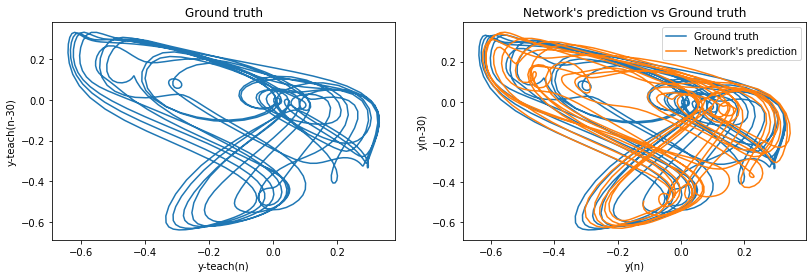

The test MSE is 0.11480913214138855
The 84 NRMSE is 0.406186931024219


In [36]:
Network.train_test_init_cond([1, 1.5, 5], test_time=1000, NRMSE=True, noise=True)

## 4.3 Comparison: T=3000 vs T=21000 <a name="Delay30_Comparison"></a>

Let us begin by wrapping up the results obtained in [Section 4.1](#Delay30_3000) and [Section 4.2](#Delay30_21000). For both cases, we have performed the same experiments in order to be able to compare them. The results obtained are the following:


<img src="Images/table_30.png" alt="table_30" width="490"/>


**Remark on the notation:** recall that the testing procedure begins with some time steps of teacher forcing, which are required in order to let the internal states of the reservoir converge. Afterwards, it can freely run for the desired number of time steps. Therefore, the notation $\text{MSE}_\text{test}(n,m)$ means the testing MSE obtained when the network freely run for $m$ time steps after $n$ steps of teacher forcing.


As already stated, the main goal is to learn the dynamics. The best way of comparing both approaches is by analyzing the values of the $\text{NRMSE}_{84}$ obtained. It can be seen that, in all the cases, the $\text{NRMSE}_{84}$ for the network trained with a sequence of length $21\,000$, is lower than with the sequence trained with $3\,000$ sample points. This implies that the former is capable of predicting a wider range of chaotic situations. 

On the other hand, we may visually infer, by looking at the plots, that when the network is trained by means of a sequence of length $21\,000$, the prediction degenerates a bit later. However, it is worth noting that, even though the prediction may degenerate, it still follows a dynamics that resembles that of a Mackey-Glass system. 

As we have already discussed, the network predicts quite precisely the next 200 or 250 time steps that follow the training and, afterwards, it degenerates. By analyzing the experiments done so far, it seems that the problem does not actually lie on the quantity of data available (since taking $T=21000$ does not suppose a big improvement) but on the network's capacity. In other words, a reservoir with 400 nodes is not capable of learning the dynamics at the extent of precisely predicting more than 250 time steps. Therefore, we are going to do the same as in [Section 3.4](#Delay17_Capacity) and we will increse the number of nodes of the reservoir.

## 4.4 Increasing network's capacity <a name="Delay30_Capacity"></a>

The network we have been dealing with so far is composed of a reservoir with 400 nodes. As we have seen, it has been enough for predicting the next 200-250 steps that follows the training but not much. In this section, we are going to increase the capacity of the network by adding more nodes to the reservoir. By doing so, we expect to increase the prediction capability of the network.

The network we will be dealing with in this section will have a reservoir with 1500 nodes. In addition, the training sequence is going to be of size $T=7000$. This is the same approach we took in [Section 3.4](#Delay17_Capacity).

Since we are changing the number of nodes, the parameters of the network have to be defined again, since their sizes are going to change.

In [5]:
#############
#Parameters of the network
#############
Network.K = 1
Network.N = 1500 #number of nodes
Network.L = 1
Network.W_in = np.random.choice([0,0.14,-0.14], Network.N, p=[0.5, 0.25, 0.25]).reshape((Network.N,Network.K))
Network.W_back = np.random.uniform(low=-0.56, high=0.56, size=Network.N).reshape((Network.N,Network.L))
Network.non_null_matrices = ["W_back", "W_in"]
Network.u = 0.2*np.ones([Network.K,1])

#############
#Reservoir
#############
Network.W = np.random.choice([0,0.4,-0.4], Network.N*Network.N, p=[0.9875, 0.00625, 0.00625]) #adjacency matrix
Network.W = Network.W.reshape((Network.N, Network.N))

#rescale Network.W
alpha = 0.79/max(abs(scipy.linalg.eigvals(Network.W)))
Network.W = alpha*Network.W
print("The maximum eigenvalue (in module) is {}".format(max(abs(scipy.linalg.eigvals(Network.W)))))
_,s,_ = scipy.linalg.svd(Network.W)

The maximum eigenvalue (in module) is 0.7899999999999862


In [6]:
Network.T = 7000
Network.n_min = 1000
Network.sigma = 30
Network.InitialCondition_ODE = [1.2]
Network.delta = 1
Network.C = 0.44
Network.a = 0.9

In [8]:
#TRAINING
#After the plots, the training MSE is printed
Network.train_network(plot=False, noise=True)

The training MSE is 2.0824871693636513e-08


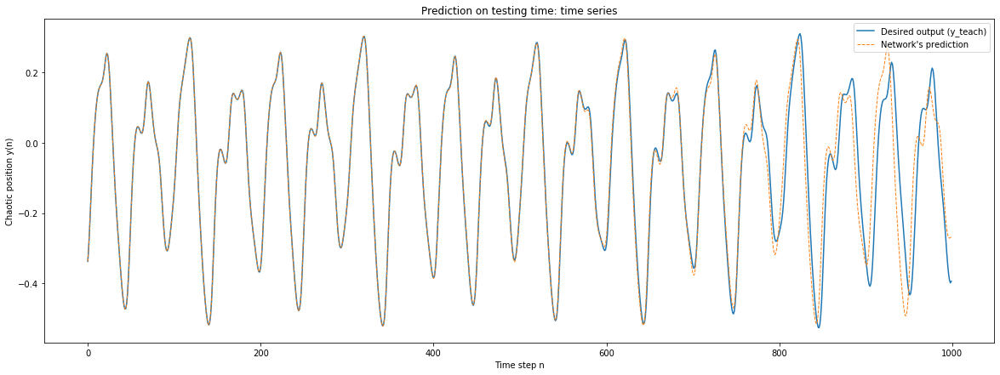

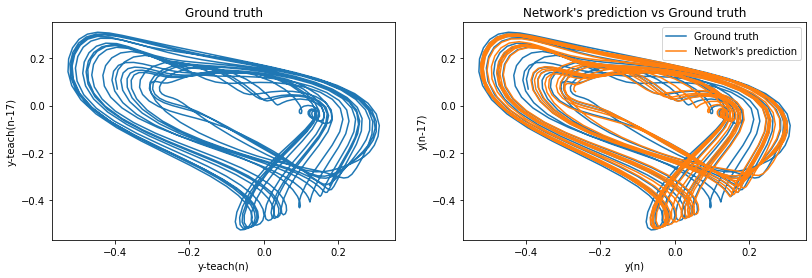

The test MSE is 0.0030426729789732173
The 84 NRMSE is 0.028945600978802617


In [9]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000)

By increasing the network's capacity, we have achieved a greater prediction capability. On the one hand, the value of the $\text{NRMSE}_\text{84}$ has been divided by 10. Therefore, this network is 10 times more precise in the long term than any of the previous ones. On the other hand, we can visually infer that, at this time, we can precisely predict almost 800 time steps against the 200 we got in previous sections.

Therefore, we may finally say that, in case of being interested in precisely predicting a certain number of $\tilde{T}$ time steps, with $\tilde{T}>>T$, we will need to increase the capacity of the network according to such desired value. However, keep in mind that, as such capacity increases, so does the computational cost.

# 5. Training the network with different delays <a name="MackeyGlass_VaryDelay" ></a>

As we already mentioned in [Section 1](#MackeyGlass_System), the Mackey-Glass dynamical system with standard parameters is chaotic whenever the delay $\sigma$ is greater than 16.8. In [Section 3](#Delay17) and [Section 4](#Delay30), we dealt with $\sigma=17$ and $\sigma=30$ respectively and we saw that the former was mildly chaotic whereas the latter was wilder. So now we are going to analyze the training behavior for some other values of $\sigma$ between 17 and 30. In particular, for $\sigma=20$, $\sigma=25$ and $\sigma=27$.

The setting for the following experiments is:
* We are going to use the same network used so far
* The network will be trained by means of a sequence of length N=3000
* When generating the points, we are going to take the standard initial condition of $y(0)=1.2$. In addition, $y(n)=0$ for $n<0$.
* We have to keep in mind that the system with $\sigma=30$ was so chaotic, that some noise needed to be introduced. Therefore, as the value of $\sigma$ increases, we will have to make use of this strategy.

Let us begin by recovering the original parameters.

In [15]:
#############
#Parameters of the network
#############
Network.K = 1
Network.N = 400 
Network.L = 1
Network.W_in = np.random.choice([0,0.14,-0.14], Network.N, p=[0.5, 0.25, 0.25]).reshape((Network.N,Network.K))
Network.W_back = np.random.uniform(low=-0.56, high=0.56, size=Network.N).reshape((Network.N,Network.L))
Network.non_null_matrices = ["W_back", "W_in"]
Network.u = 0.2*np.ones([Network.K,1])

#############
#Reservoir
#############
Network.W = np.random.choice([0,0.4,-0.4], Network.N*Network.N, p=[0.9875, 0.00625, 0.00625]) #adjacency matrix
Network.W = Network.W.reshape((Network.N, Network.N))

#rescale Network.W
alpha = 0.79/max(abs(scipy.linalg.eigvals(Network.W)))
Network.W = alpha*Network.W
print("The maximum eigenvalue (in module) is {}".format(max(abs(scipy.linalg.eigvals(Network.W)))))
_,s,_ = scipy.linalg.svd(Network.W)

The maximum eigenvalue (in module) is 0.7899999999999876


## 5.1 $\sigma=20$ <a name="VaryDelay_20" ></a>

In [16]:
Network.T = 3000
Network.n_min = 1000
Network.sigma = 20
Network.InitialCondition_ODE = [1.2]

### Training without noise

In [17]:
Network.train_network(plot=False)

The training MSE is 5.134897733235676e-10


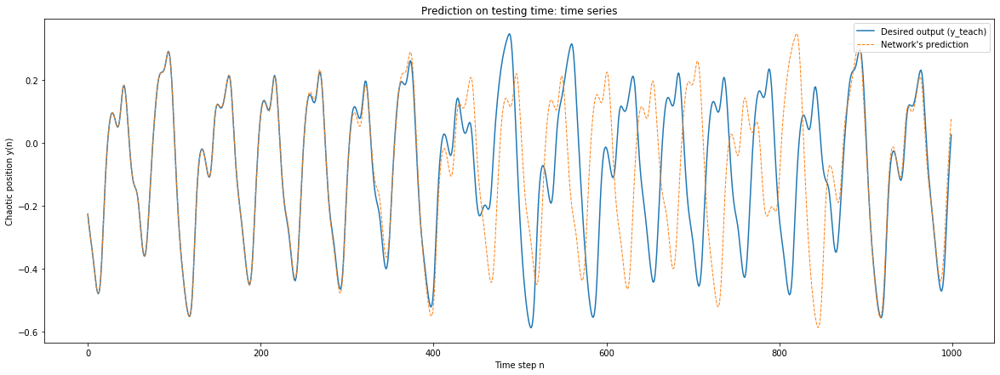

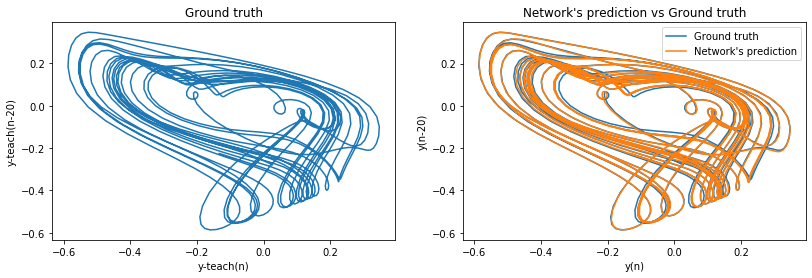

The test MSE is 0.058060820904558004
The 84 NRMSE is 0.04821722390015305


In [19]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000, NRMSE=True)

Notice that the prediction is quite accurate during the first 400 time steps. **Notice that, after that, it degenerates until 850-900 time steps, when it recovers precision**. In addition, the $\text{NRMSE}_{84}$ is quite low, which implies that it can deal with a considerably variety of chaos levels. We have also tried to add some noise while training the network and we obtained a very similar result when the boundary of such noise was very small (of the order of $10^{-8}$). However, as this value increases until the default value and beyond, the prediction got worse.

## 5.2 $\sigma=25$ <a name="VaryDelay_25" ></a>

In [20]:
Network.sigma = 25

### Training without noise

In [25]:
Network.train_network(plot=False)

The training MSE is 6.89934001321996e-09


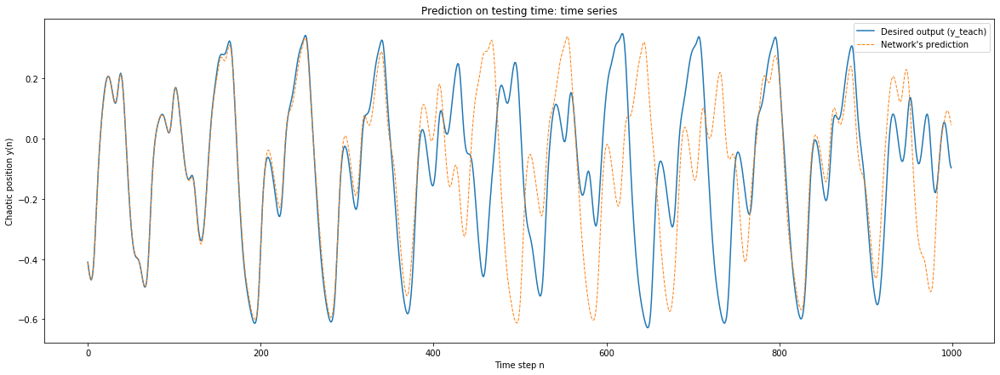

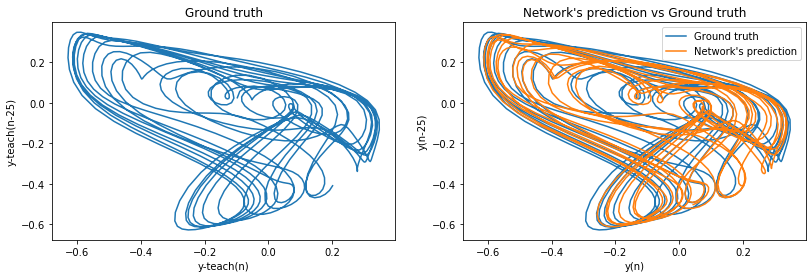

The test MSE is 0.06275265409698413
The 84 NRMSE is 0.3805396542794711


In [26]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000, NRMSE=True)

After teacher forcing the network with 1000 samples, it is able to autonomously run for 300 steps more until it begins to degenerate. In fact, notice that it jumps from -1 to 1. This implies that the predictions quite large in module but the tanh keeps it at -1 and 1. In addition, observe that the $\text{NRMSE}_{84}$ has increased a lot, meaning a lower capacity for dealing with chaotic situations.

### Training with noise

In [33]:
Network.train_network(plot=False, noise=True, boundary_noise=0.0000001)

The training MSE is 1.252820765694335e-08


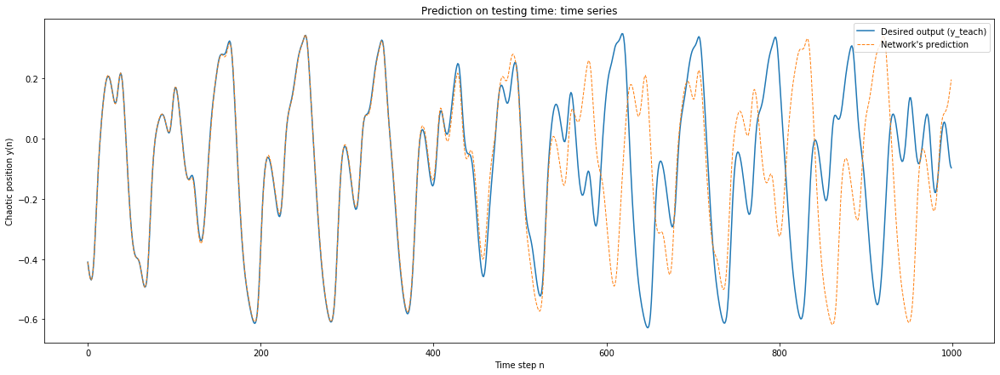

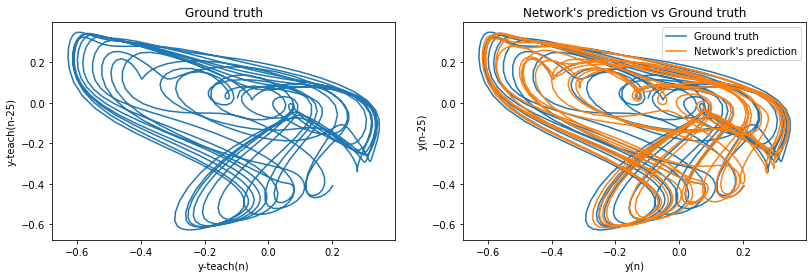

The test MSE is 0.07051532764183466
The 84 NRMSE is 0.31958523895855573


In [34]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000, NRMSE=True)

After adding some noise during training, the network has become a little bit more robust. Therefore, the accuracy of the prediction has increased. Observed that, without noise, we could precisely predict around 300 time steps whereas, after adding some noise, we could precisely predict around 400 time steps. In addition, the $\text{NRMSE}_{84}$ is slightly lower. 

Some experiments varying the boundary of the noise interval have been performed. However, the best results were obtained by taking [-0.0000001,0.0000001].

## 5.3 $\sigma=27$ <a name="VaryDelay_27" ></a>

In [41]:
Network.sigma = 27

### Training without noise

In [42]:
Network.train_network(plot=False)

The training MSE is 1.4582640532358192e-08


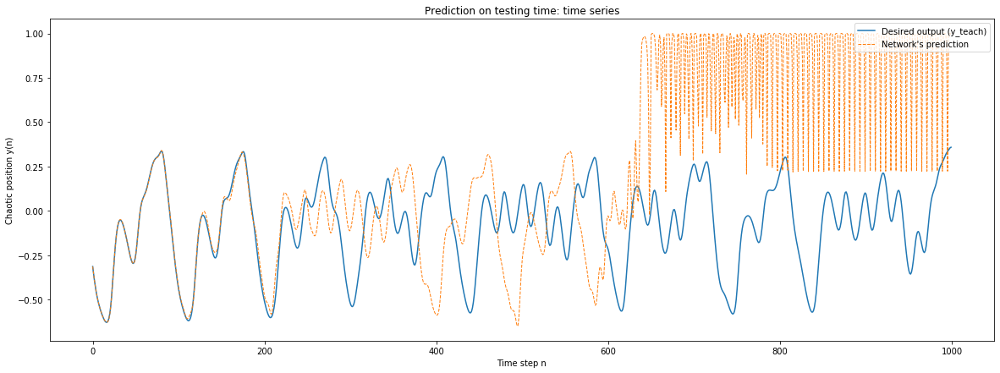

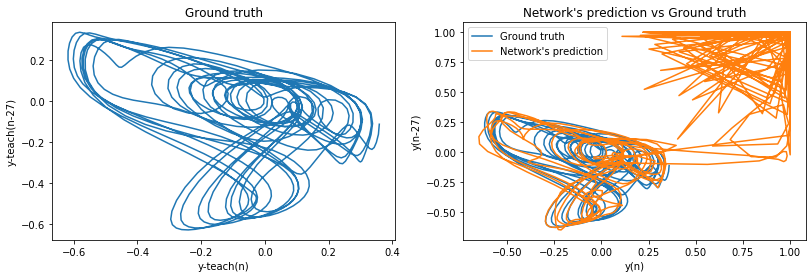

The test MSE is 0.3848216936293601
The 84 NRMSE is 6.010128122770383


In [43]:
Network.test_network(t_dismiss=1000, t_autonom=1000, NRMSE=True)

After 200 time steps it begins to degenerate. However, it still follows a dynamics that resembles that of a Mackey-Glass until 600 time steps, where it spikes to value 1. This implies that the prediction was very large in module and the tanh collapsed such value into 1. From this point on, the prediction follows a dynamics that has nothing to do with the one we wanted to learn.

### Training with noise

In [44]:
Network.train_network(plot=False, noise=True)

The training MSE is 2.1984778321959083e-07


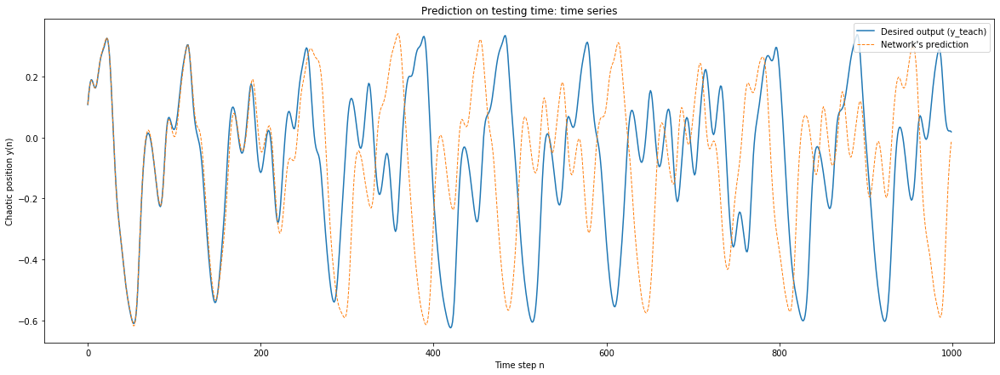

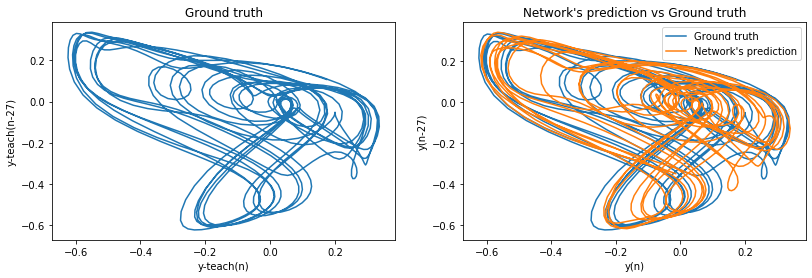

The test MSE is 0.10842363665470128
The 84 NRMSE is 0.5106762340371375


In [46]:
Network.test_network(t_dismiss=Network.T, t_autonom=1000, NRMSE=True)

After adding some noise, the $\text{NRMSE}_{84}$ considerably decreases. However, observe that, by means of this approach, we are quite capable of predicting a chaotic Mackey-Glass system to a certain extent. That is, as the value of $\sigma$ increases, so does the difficulty of training the network. Moreover, the degree of chaos tends to increase as time goes by, which hardens prediction. Notice that this result is quite similar to the one we previosly did taking the same parameters for $\sigma=30$.